In [1]:
from openff.toolkit.topology.molecule import FrozenMolecule, Molecule
# from openff.toolkit.utils.toolkits import RDKitToolkitWrapper, OpenEyeToolkitWrapper
from rdkit import Chem
from create_smarts_substructure import *
from polymer_utils import ParsePolymer

In [21]:
mol = Molecule.from_smiles('CCCCCCCCCCCCCC')
mol.generate_conformers()
confs = mol._conformers
mol._conformers = [mol._conformers[0]]

In [22]:
view = rdkit_visualize(mol.to_rdkit(), show_3D=True, grey_highlight_ids=[], yellow_highlight_ids=[])

In [56]:
view._execute_js_code("document.nglview = this;")


In [55]:
view._execute_js_code(
"""
this = "lskjdflskjdfsldf"
""")

In [47]:
view

NGLWidget(n_components=1, picked={'atom1': {'index': 3, 'residueIndex': 0, 'resname': 'SG', 'x': 0.18500000238…

In [50]:
view.picked

{'bond': {'atomIndex1': 0, 'atomIndex2': 1, 'bondOrder': 1},
 'atom1': {'index': 0,
  'residueIndex': 0,
  'resname': 'SG',
  'x': -1.2929999828338623,
  'y': -7.552000045776367,
  'z': 1.3519999980926514,
  'element': 'C',
  'chainname': 'A',
  'resno': 0,
  'serial': 1,
  'vdw': 1.7,
  'covalent': 0.76,
  'hetero': 0,
  'bfactor': 0,
  'altloc': 'f',
  'atomname': 'SFD',
  'modelIndex': 0,
  'name': '[SG]0:A.SFD%f'},
 'atom2': {'index': 1,
  'residueIndex': 0,
  'resname': 'SG',
  'x': -0.36000001430511475,
  'y': -6.395999908447266,
  'z': 1.6820000410079956,
  'element': 'C',
  'chainname': 'A',
  'resno': 0,
  'serial': 2,
  'vdw': 1.7,
  'covalent': 0.76,
  'hetero': 0,
  'bfactor': 0,
  'altloc': 'f',
  'atomname': 'SFD',
  'modelIndex': 0,
  'name': '[SG]0:A.SFD%f'},
 'component': 0}

In [42]:
view._execute_js_code(
"""
window.alert(this.stage.compList[0].pickDict.values[0])
""")

In [4]:
selected_atoms = get_atoms_between_rdmol(mol.to_rdkit(), [11,8], 10)
smarts, rdmol = get_smarts_substructure_from_rdkit_idx(mol, ids=selected_atoms)
print(smarts)


[#6:1](-[#6:2](-[H:5])-[H:6])(-[H:3])-[H:4]


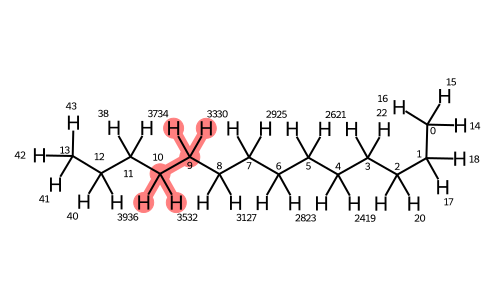

In [5]:
mol.visualize(backend='rdkit', highlight_ids=selected_atoms)

# PDB Reading For Rubber

In [2]:
file = 'polymer_examples/rdkit_simple_polymers/naturalrubber.pdb'

mol = Molecule.from_pdb(file)
rdmol = Chem.rdmolfiles.MolFromPDBFile(file)
assigned_atoms = set()
for atom in mol.atoms:
    if atom.metadata['already_matched']:
        assigned_atoms.add(atom.molecule_atom_index)
print(assigned_atoms)

NATURALRUBBER
[C:1](-[H:2])(-[H:3])(-[H:4])-[C:5](=[C:6](-[H:7])-[C:8](-[H:9])-[H:10])-[C:11](-[H:12])(-[H:13])-[H:14]
NATURALRUBBER
[C:1](-[H:2])(-[H:3])-[C:4](=[C:5](-[H:6])-[C:7](-[H:8])(-[H:9])-[H:10])-[C:11](-[H:12])(-[H:13])-[H:14]
NATURALRUBBER
[C:1](-[H:2])(-[H:3])-[C:4](=[C:5](-[H:6])-[C:7](-[H:8])-[H:9])-[C:10](-[H:11])(-[H:12])-[H:13]
DEFAULT_MONOMER_BOND
[C:1]([H:3])([H:4])[C:2]([H:5])([H:6])
N. of assigned nodes: 106 -- N. of atoms: 106
N. of assigned edges: 112 -- N. of bonds: 105
0 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'C', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'NATURALRUBBER: [C:1](-[H:2])(-[H:3])-[C:4](=[C:5](-[H:6])-[C:7](-[H:8])(-[H:9])-[H:10])-[C:11](-[H:12])(-[H:13])-[H:14]', 'connors_residue_number': 2, 'connors_atom_name': 'C1'}
Formal charge: 0
1 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'H', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_nam

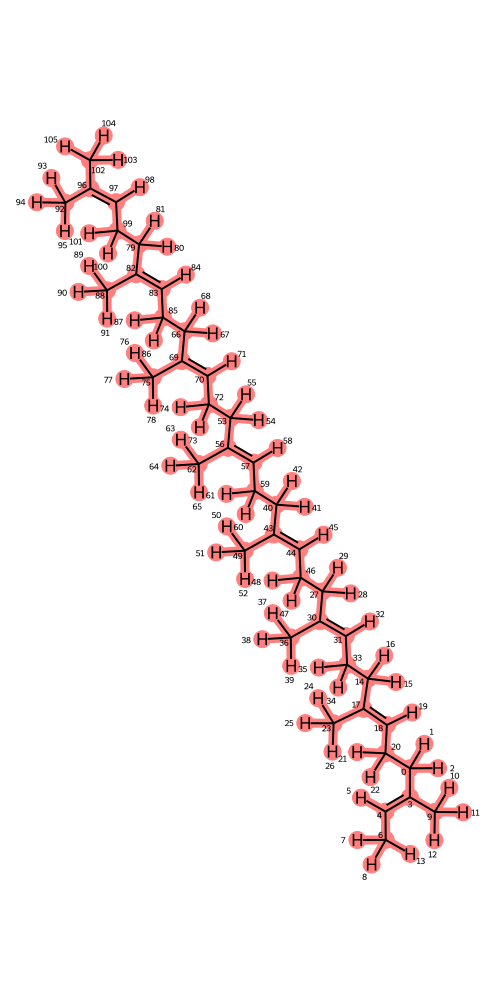

In [3]:
mol.visualize(backend='rdkit', height=1000, highlight_ids=list(assigned_atoms))

In [14]:
for bond in mol.bonds:
    print(bond.bond_order)

1
1
1
1
2
1
1
1
1
1
1
1
1
1
1
1
1
1
2
1
1
1
1
1
1
1
1
1
1
1
1
2
1
1
1
1
1
1
1
1
1
1
1
1
2
1
1
1
1
1
1
1
1
1
1
1
1
2
1
1
1
1
1
1
1
1
1
1
1
1
2
1
1
1
1
1
1
1
1
1
1
1
1
2
1
1
1
1
1
1
1
1
1
1
1
1
2
1
1
1
1
1
1
1
1


In [15]:
atom = rdmol.GetAtomWithIdx(20)
dir(atom)

['ClearProp',
 'DescribeQuery',
 'GetAtomMapNum',
 'GetAtomicNum',
 'GetBonds',
 'GetBoolProp',
 'GetChiralTag',
 'GetDegree',
 'GetDoubleProp',
 'GetExplicitBitVectProp',
 'GetExplicitValence',
 'GetFormalCharge',
 'GetHybridization',
 'GetIdx',
 'GetImplicitValence',
 'GetIntProp',
 'GetIsAromatic',
 'GetIsotope',
 'GetMass',
 'GetMonomerInfo',
 'GetNeighbors',
 'GetNoImplicit',
 'GetNumExplicitHs',
 'GetNumImplicitHs',
 'GetNumRadicalElectrons',
 'GetOwningMol',
 'GetPDBResidueInfo',
 'GetProp',
 'GetPropNames',
 'GetPropsAsDict',
 'GetSmarts',
 'GetSymbol',
 'GetTotalDegree',
 'GetTotalNumHs',
 'GetTotalValence',
 'GetUnsignedProp',
 'HasOwningMol',
 'HasProp',
 'HasQuery',
 'InvertChirality',
 'IsInRing',
 'IsInRingSize',
 'Match',
 'NeedsUpdatePropertyCache',
 'SetAtomMapNum',
 'SetAtomicNum',
 'SetBoolProp',
 'SetChiralTag',
 'SetDoubleProp',
 'SetExplicitBitVectProp',
 'SetFormalCharge',
 'SetHybridization',
 'SetIntProp',
 'SetIsAromatic',
 'SetIsotope',
 'SetMonomerInfo',
 'S

POLYETHYLENE
[C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]
DEFAULT_MONOMER_BOND
[C:1]([H:3])([H:4])[C:2]([H:5])([H:6])
N. of assigned nodes: 4800 -- N. of atoms: 4808
N. of assigned edges: 6392 -- N. of bonds: 4804
0 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'C', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 1, 'connors_atom_name': 'C1'}
Formal charge: 0
1 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'H', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 1, 'connors_atom_name': 'H3'}
Formal charge: 0
2 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'H1', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'co

457 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'C2_', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 77, 'connors_atom_name': 'C1'}
Formal charge: 0
458 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'H4S', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 77, 'connors_atom_name': 'H3'}
Formal charge: 0
459 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'H4T', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 77, 'connors_atom_name': 'H4'}
Formal charge: 0
460 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'C2+', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched':

798 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'H7t', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 133, 'connors_atom_name': 'H2'}
Formal charge: 0
799 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'C4f', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 134, 'connors_atom_name': 'C1'}
Formal charge: 0
800 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'H7u', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 134, 'connors_atom_name': 'H3'}
Formal charge: 0
801 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'H7v', 'residue_name': 'UNL', 'residue_number': 0, 'already_matche

1118 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'H9?', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 187, 'connors_atom_name': 'H3'}
Formal charge: 0
1119 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'H9>', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 187, 'connors_atom_name': 'H4'}
Formal charge: 0
1120 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'C5C', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 187, 'connors_atom_name': 'C2'}
Formal charge: 0
1121 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'H9-', 'residue_name': 'UNL', 'residue_number': 0, 'already_ma

1407 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'C6N', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 235, 'connors_atom_name': 'C1'}
Formal charge: 0
1408 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'Hcg', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 235, 'connors_atom_name': 'H3'}
Formal charge: 0
1409 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'Hch', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 235, 'connors_atom_name': 'H4'}
Formal charge: 0
1410 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'C6O', 'residue_name': 'UNL', 'residue_number': 0, 'already_ma

1602 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'C7u', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 267, 'connors_atom_name': 'C2'}
Formal charge: 0
1603 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'Hd!', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 267, 'connors_atom_name': 'H1'}
Formal charge: 0
1604 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'Hd@', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 267, 'connors_atom_name': 'H2'}
Formal charge: 0
1605 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'C7v', 'residue_name': 'UNL', 'residue_number': 0, 'already_ma

1795 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'Hfm', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 299, 'connors_atom_name': 'H1'}
Formal charge: 0
1796 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'Hfn', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 299, 'connors_atom_name': 'H2'}
Formal charge: 0
1797 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'C8b', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 300, 'connors_atom_name': 'C1'}
Formal charge: 0
1798 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'Hfo', 'residue_name': 'UNL', 'residue_number': 0, 'already_ma

2144 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'Hi3', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 357, 'connors_atom_name': 'H2'}
Formal charge: 0
2145 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'C9H', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 358, 'connors_atom_name': 'C1'}
Formal charge: 0
2146 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'Hi4', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 358, 'connors_atom_name': 'H3'}
Formal charge: 0
2147 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'Hi5', 'residue_name': 'UNL', 'residue_number': 0, 'already_ma

2359 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'Hj!', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 393, 'connors_atom_name': 'H1'}
Formal charge: 0
2360 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'Hj@', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 393, 'connors_atom_name': 'H2'}
Formal charge: 0
2361 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'Cav', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 394, 'connors_atom_name': 'C1'}
Formal charge: 0
2362 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'Hj#', 'residue_name': 'UNL', 'residue_number': 0, 'already_ma

Formal charge: 0
2683 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'Hmr', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 447, 'connors_atom_name': 'H4'}
Formal charge: 0
2684 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'CbS', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 447, 'connors_atom_name': 'C2'}
Formal charge: 0
2685 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'Hms', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 447, 'connors_atom_name': 'H1'}
Formal charge: 0
2686 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'Hmt', 'residue_name': 'UNL', 'residue_number

2966 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'Cc#', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 494, 'connors_atom_name': 'C2'}
Formal charge: 0
2967 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'HoM', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 494, 'connors_atom_name': 'H1'}
Formal charge: 0
2968 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'HoN', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 494, 'connors_atom_name': 'H2'}
Formal charge: 0
2969 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'Cc$', 'residue_name': 'UNL', 'residue_number': 0, 'already_ma

3278 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'Cd~', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 546, 'connors_atom_name': 'C2'}
Formal charge: 0
3279 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'Hr4', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 546, 'connors_atom_name': 'H1'}
Formal charge: 0
3280 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'Hr5', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 546, 'connors_atom_name': 'H2'}
Formal charge: 0
3281 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'Ce1', 'residue_name': 'UNL', 'residue_number': 0, 'already_ma

Formal charge: 0
3586 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'HtF', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 597, 'connors_atom_name': 'H2'}
Formal charge: 0
3587 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'Cfj', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 598, 'connors_atom_name': 'C1'}
Formal charge: 0
3588 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'HtG', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 598, 'connors_atom_name': 'H3'}
Formal charge: 0
3589 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'HtH', 'residue_name': 'UNL', 'residue_number

Formal charge: 0
3946 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'CgS', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 657, 'connors_atom_name': 'C2'}
Formal charge: 0
3947 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'Hwu', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 657, 'connors_atom_name': 'H1'}
Formal charge: 0
3948 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'Hwv', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 657, 'connors_atom_name': 'H2'}
Formal charge: 0
3949 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'CgT', 'residue_name': 'UNL', 'residue_number

4105 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'Chn', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 684, 'connors_atom_name': 'C1'}
Formal charge: 0
4106 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'HxQ', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 684, 'connors_atom_name': 'H3'}
Formal charge: 0
4107 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'HxR', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 684, 'connors_atom_name': 'H4'}
Formal charge: 0
4108 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'Cho', 'residue_name': 'UNL', 'residue_number': 0, 'already_ma

4230 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'HzP', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 704, 'connors_atom_name': 'H2'}
Formal charge: 0
4231 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'Ch$', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 705, 'connors_atom_name': 'C1'}
Formal charge: 0
4232 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'HzQ', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 705, 'connors_atom_name': 'H3'}
Formal charge: 0
4233 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'HzR', 'residue_name': 'UNL', 'residue_number': 0, 'already_ma

Formal charge: 0
4432 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'CiM', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 738, 'connors_atom_name': 'C2'}
Formal charge: 0
4433 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'HAi', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 738, 'connors_atom_name': 'H1'}
Formal charge: 0
4434 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'HAj', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 738, 'connors_atom_name': 'H2'}
Formal charge: 0
4435 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'CiN', 'residue_name': 'UNL', 'residue_number

4647 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'HB=', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 774, 'connors_atom_name': 'H4'}
Formal charge: 0
4648 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'CjA', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 774, 'connors_atom_name': 'C2'}
Formal charge: 0
4649 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'HB:', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 774, 'connors_atom_name': 'H1'}
Formal charge: 0
4650 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'HB}', 'residue_name': 'UNL', 'residue_number': 0, 'already_ma

4740 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'HCT', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 789, 'connors_atom_name': 'H2'}
Formal charge: 0
4741 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'Cj^', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 790, 'connors_atom_name': 'C1'}
Formal charge: 0
4742 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'HCU', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE: [C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]', 'connors_residue_number': 790, 'connors_atom_name': 'H3'}
Formal charge: 0
4743 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'HCV', 'residue_name': 'UNL', 'residue_number': 0, 'already_ma

(193, 196) {'bond_order': 1}
(196, 197) {'bond_order': 1}
(196, 198) {'bond_order': 1}
(196, 199) {'bond_order': 1}
(199, 200) {'bond_order': 1}
(199, 201) {'bond_order': 1}
(199, 202) {'bond_order': 1}
(202, 203) {'bond_order': 1}
(202, 204) {'bond_order': 1}
(202, 205) {'bond_order': 1}
(205, 206) {'bond_order': 1}
(205, 207) {'bond_order': 1}
(205, 208) {'bond_order': 1}
(208, 209) {'bond_order': 1}
(208, 210) {'bond_order': 1}
(208, 211) {'bond_order': 1}
(211, 212) {'bond_order': 1}
(211, 213) {'bond_order': 1}
(211, 214) {'bond_order': 1}
(214, 215) {'bond_order': 1}
(214, 216) {'bond_order': 1}
(214, 217) {'bond_order': 1}
(217, 218) {'bond_order': 1}
(217, 219) {'bond_order': 1}
(217, 220) {'bond_order': 1}
(220, 221) {'bond_order': 1}
(220, 222) {'bond_order': 1}
(220, 223) {'bond_order': 1}
(223, 224) {'bond_order': 1}
(223, 225) {'bond_order': 1}
(223, 226) {'bond_order': 1}
(226, 227) {'bond_order': 1}
(226, 228) {'bond_order': 1}
(226, 229) {'bond_order': 1}
(229, 230) {'b

(613, 614) {'bond_order': 1}
(613, 615) {'bond_order': 1}
(613, 616) {'bond_order': 1}
(616, 617) {'bond_order': 1}
(616, 618) {'bond_order': 1}
(616, 619) {'bond_order': 1}
(619, 620) {'bond_order': 1}
(619, 621) {'bond_order': 1}
(619, 622) {'bond_order': 1}
(622, 623) {'bond_order': 1}
(622, 624) {'bond_order': 1}
(622, 625) {'bond_order': 1}
(625, 626) {'bond_order': 1}
(625, 627) {'bond_order': 1}
(625, 628) {'bond_order': 1}
(628, 629) {'bond_order': 1}
(628, 630) {'bond_order': 1}
(628, 631) {'bond_order': 1}
(631, 632) {'bond_order': 1}
(631, 633) {'bond_order': 1}
(631, 634) {'bond_order': 1}
(634, 635) {'bond_order': 1}
(634, 636) {'bond_order': 1}
(634, 637) {'bond_order': 1}
(637, 638) {'bond_order': 1}
(637, 639) {'bond_order': 1}
(637, 640) {'bond_order': 1}
(640, 641) {'bond_order': 1}
(640, 642) {'bond_order': 1}
(640, 643) {'bond_order': 1}
(643, 644) {'bond_order': 1}
(643, 645) {'bond_order': 1}
(643, 646) {'bond_order': 1}
(646, 647) {'bond_order': 1}
(646, 648) {'b

(991, 992) {'bond_order': 1}
(991, 993) {'bond_order': 1}
(991, 994) {'bond_order': 1}
(994, 995) {'bond_order': 1}
(994, 996) {'bond_order': 1}
(994, 997) {'bond_order': 1}
(997, 998) {'bond_order': 1}
(997, 999) {'bond_order': 1}
(997, 1000) {'bond_order': 1}
(1000, 1001) {'bond_order': 1}
(1000, 1002) {'bond_order': 1}
(1000, 1003) {'bond_order': 1}
(1003, 1004) {'bond_order': 1}
(1003, 1005) {'bond_order': 1}
(1003, 1006) {'bond_order': 1}
(1006, 1007) {'bond_order': 1}
(1006, 1008) {'bond_order': 1}
(1006, 1009) {'bond_order': 1}
(1009, 1010) {'bond_order': 1}
(1009, 1011) {'bond_order': 1}
(1009, 1012) {'bond_order': 1}
(1012, 1013) {'bond_order': 1}
(1012, 1014) {'bond_order': 1}
(1012, 1015) {'bond_order': 1}
(1015, 1016) {'bond_order': 1}
(1015, 1017) {'bond_order': 1}
(1015, 1018) {'bond_order': 1}
(1018, 1019) {'bond_order': 1}
(1018, 1020) {'bond_order': 1}
(1018, 1021) {'bond_order': 1}
(1021, 1022) {'bond_order': 1}
(1021, 1023) {'bond_order': 1}
(1021, 1024) {'bond_order

(1515, 1518) {'bond_order': 1}
(1518, 1519) {'bond_order': 1}
(1518, 1520) {'bond_order': 1}
(1518, 1521) {'bond_order': 1}
(1521, 1522) {'bond_order': 1}
(1521, 1523) {'bond_order': 1}
(1521, 1524) {'bond_order': 1}
(1524, 1525) {'bond_order': 1}
(1524, 1526) {'bond_order': 1}
(1524, 1527) {'bond_order': 1}
(1527, 1528) {'bond_order': 1}
(1527, 1529) {'bond_order': 1}
(1527, 1530) {'bond_order': 1}
(1530, 1531) {'bond_order': 1}
(1530, 1532) {'bond_order': 1}
(1530, 1533) {'bond_order': 1}
(1533, 1534) {'bond_order': 1}
(1533, 1535) {'bond_order': 1}
(1533, 1536) {'bond_order': 1}
(1536, 1537) {'bond_order': 1}
(1536, 1538) {'bond_order': 1}
(1536, 1539) {'bond_order': 1}
(1539, 1540) {'bond_order': 1}
(1539, 1541) {'bond_order': 1}
(1539, 1542) {'bond_order': 1}
(1542, 1543) {'bond_order': 1}
(1542, 1544) {'bond_order': 1}
(1542, 1545) {'bond_order': 1}
(1545, 1546) {'bond_order': 1}
(1545, 1547) {'bond_order': 1}
(1545, 1548) {'bond_order': 1}
(1548, 1549) {'bond_order': 1}
(1548, 1

(1971, 1974) {'bond_order': 1}
(1974, 1975) {'bond_order': 1}
(1974, 1976) {'bond_order': 1}
(1974, 1977) {'bond_order': 1}
(1977, 1978) {'bond_order': 1}
(1977, 1979) {'bond_order': 1}
(1977, 1980) {'bond_order': 1}
(1980, 1981) {'bond_order': 1}
(1980, 1982) {'bond_order': 1}
(1980, 1983) {'bond_order': 1}
(1983, 1984) {'bond_order': 1}
(1983, 1985) {'bond_order': 1}
(1983, 1986) {'bond_order': 1}
(1986, 1987) {'bond_order': 1}
(1986, 1988) {'bond_order': 1}
(1986, 1989) {'bond_order': 1}
(1989, 1990) {'bond_order': 1}
(1989, 1991) {'bond_order': 1}
(1989, 1992) {'bond_order': 1}
(1992, 1993) {'bond_order': 1}
(1992, 1994) {'bond_order': 1}
(1992, 1995) {'bond_order': 1}
(1995, 1996) {'bond_order': 1}
(1995, 1997) {'bond_order': 1}
(1995, 1998) {'bond_order': 1}
(1998, 1999) {'bond_order': 1}
(1998, 2000) {'bond_order': 1}
(1998, 2001) {'bond_order': 1}
(2001, 2002) {'bond_order': 1}
(2001, 2003) {'bond_order': 1}
(2001, 2004) {'bond_order': 1}
(2004, 2005) {'bond_order': 1}
(2004, 2

(2313, 2315) {'bond_order': 1}
(2313, 2316) {'bond_order': 1}
(2316, 2317) {'bond_order': 1}
(2316, 2318) {'bond_order': 1}
(2316, 2319) {'bond_order': 1}
(2319, 2320) {'bond_order': 1}
(2319, 2321) {'bond_order': 1}
(2319, 2322) {'bond_order': 1}
(2322, 2323) {'bond_order': 1}
(2322, 2324) {'bond_order': 1}
(2322, 2325) {'bond_order': 1}
(2325, 2326) {'bond_order': 1}
(2325, 2327) {'bond_order': 1}
(2325, 2328) {'bond_order': 1}
(2328, 2329) {'bond_order': 1}
(2328, 2330) {'bond_order': 1}
(2328, 2331) {'bond_order': 1}
(2331, 2332) {'bond_order': 1}
(2331, 2333) {'bond_order': 1}
(2331, 2334) {'bond_order': 1}
(2334, 2335) {'bond_order': 1}
(2334, 2336) {'bond_order': 1}
(2334, 2337) {'bond_order': 1}
(2337, 2338) {'bond_order': 1}
(2337, 2339) {'bond_order': 1}
(2337, 2340) {'bond_order': 1}
(2340, 2341) {'bond_order': 1}
(2340, 2342) {'bond_order': 1}
(2340, 2343) {'bond_order': 1}
(2343, 2344) {'bond_order': 1}
(2343, 2345) {'bond_order': 1}
(2343, 2346) {'bond_order': 1}
(2346, 2

(2777, 2779) {'bond_order': 1}
(2777, 2780) {'bond_order': 1}
(2780, 2781) {'bond_order': 1}
(2780, 2782) {'bond_order': 1}
(2780, 2783) {'bond_order': 1}
(2783, 2784) {'bond_order': 1}
(2783, 2785) {'bond_order': 1}
(2783, 2786) {'bond_order': 1}
(2786, 2787) {'bond_order': 1}
(2786, 2788) {'bond_order': 1}
(2786, 2789) {'bond_order': 1}
(2789, 2790) {'bond_order': 1}
(2789, 2791) {'bond_order': 1}
(2789, 2792) {'bond_order': 1}
(2792, 2793) {'bond_order': 1}
(2792, 2794) {'bond_order': 1}
(2792, 2795) {'bond_order': 1}
(2795, 2796) {'bond_order': 1}
(2795, 2797) {'bond_order': 1}
(2795, 2798) {'bond_order': 1}
(2798, 2799) {'bond_order': 1}
(2798, 2800) {'bond_order': 1}
(2798, 2801) {'bond_order': 1}
(2801, 2802) {'bond_order': 1}
(2801, 2803) {'bond_order': 1}
(2801, 2804) {'bond_order': 1}
(2804, 2805) {'bond_order': 1}
(2804, 2806) {'bond_order': 1}
(2804, 2807) {'bond_order': 1}
(2807, 2808) {'bond_order': 1}
(2807, 2809) {'bond_order': 1}
(2807, 2810) {'bond_order': 1}
(2810, 2

(3206, 3207) {'bond_order': 1}
(3206, 3208) {'bond_order': 1}
(3206, 3209) {'bond_order': 1}
(3209, 3210) {'bond_order': 1}
(3209, 3211) {'bond_order': 1}
(3209, 3212) {'bond_order': 1}
(3212, 3213) {'bond_order': 1}
(3212, 3214) {'bond_order': 1}
(3212, 3215) {'bond_order': 1}
(3215, 3216) {'bond_order': 1}
(3215, 3217) {'bond_order': 1}
(3215, 3218) {'bond_order': 1}
(3218, 3219) {'bond_order': 1}
(3218, 3220) {'bond_order': 1}
(3218, 3221) {'bond_order': 1}
(3221, 3222) {'bond_order': 1}
(3221, 3223) {'bond_order': 1}
(3221, 3224) {'bond_order': 1}
(3224, 3225) {'bond_order': 1}
(3224, 3226) {'bond_order': 1}
(3224, 3227) {'bond_order': 1}
(3227, 3228) {'bond_order': 1}
(3227, 3229) {'bond_order': 1}
(3227, 3230) {'bond_order': 1}
(3230, 3231) {'bond_order': 1}
(3230, 3232) {'bond_order': 1}
(3230, 3233) {'bond_order': 1}
(3233, 3234) {'bond_order': 1}
(3233, 3235) {'bond_order': 1}
(3233, 3236) {'bond_order': 1}
(3236, 3237) {'bond_order': 1}
(3236, 3238) {'bond_order': 1}
(3236, 3

(3610, 3613) {'bond_order': 1}
(3613, 3614) {'bond_order': 1}
(3613, 3615) {'bond_order': 1}
(3613, 3616) {'bond_order': 1}
(3616, 3617) {'bond_order': 1}
(3616, 3618) {'bond_order': 1}
(3616, 3619) {'bond_order': 1}
(3619, 3620) {'bond_order': 1}
(3619, 3621) {'bond_order': 1}
(3619, 3622) {'bond_order': 1}
(3622, 3623) {'bond_order': 1}
(3622, 3624) {'bond_order': 1}
(3622, 3625) {'bond_order': 1}
(3625, 3626) {'bond_order': 1}
(3625, 3627) {'bond_order': 1}
(3625, 3628) {'bond_order': 1}
(3628, 3629) {'bond_order': 1}
(3628, 3630) {'bond_order': 1}
(3628, 3631) {'bond_order': 1}
(3631, 3632) {'bond_order': 1}
(3631, 3633) {'bond_order': 1}
(3631, 3634) {'bond_order': 1}
(3634, 3635) {'bond_order': 1}
(3634, 3636) {'bond_order': 1}
(3634, 3637) {'bond_order': 1}
(3637, 3638) {'bond_order': 1}
(3637, 3639) {'bond_order': 1}
(3637, 3640) {'bond_order': 1}
(3640, 3641) {'bond_order': 1}
(3640, 3642) {'bond_order': 1}
(3640, 3643) {'bond_order': 1}
(3643, 3644) {'bond_order': 1}
(3643, 3

(4180, 4182) {'bond_order': 1}
(4180, 4183) {'bond_order': 1}
(4183, 4184) {'bond_order': 1}
(4183, 4185) {'bond_order': 1}
(4183, 4186) {'bond_order': 1}
(4186, 4187) {'bond_order': 1}
(4186, 4188) {'bond_order': 1}
(4186, 4189) {'bond_order': 1}
(4189, 4190) {'bond_order': 1}
(4189, 4191) {'bond_order': 1}
(4189, 4192) {'bond_order': 1}
(4192, 4193) {'bond_order': 1}
(4192, 4194) {'bond_order': 1}
(4192, 4195) {'bond_order': 1}
(4195, 4196) {'bond_order': 1}
(4195, 4197) {'bond_order': 1}
(4195, 4198) {'bond_order': 1}
(4198, 4199) {'bond_order': 1}
(4198, 4200) {'bond_order': 1}
(4198, 4201) {'bond_order': 1}
(4201, 4202) {'bond_order': 1}
(4201, 4203) {'bond_order': 1}
(4201, 4204) {'bond_order': 1}
(4204, 4205) {'bond_order': 1}
(4204, 4206) {'bond_order': 1}
(4204, 4207) {'bond_order': 1}
(4207, 4208) {'bond_order': 1}
(4207, 4209) {'bond_order': 1}
(4207, 4210) {'bond_order': 1}
(4210, 4211) {'bond_order': 1}
(4210, 4212) {'bond_order': 1}
(4210, 4213) {'bond_order': 1}
(4213, 4

(4624, 4627) {'bond_order': 1}
(4627, 4628) {'bond_order': 1}
(4627, 4629) {'bond_order': 1}
(4627, 4630) {'bond_order': 1}
(4630, 4631) {'bond_order': 1}
(4630, 4632) {'bond_order': 1}
(4630, 4633) {'bond_order': 1}
(4633, 4634) {'bond_order': 1}
(4633, 4635) {'bond_order': 1}
(4633, 4636) {'bond_order': 1}
(4636, 4637) {'bond_order': 1}
(4636, 4638) {'bond_order': 1}
(4636, 4639) {'bond_order': 1}
(4639, 4640) {'bond_order': 1}
(4639, 4641) {'bond_order': 1}
(4639, 4642) {'bond_order': 1}
(4642, 4643) {'bond_order': 1}
(4642, 4644) {'bond_order': 1}
(4642, 4645) {'bond_order': 1}
(4645, 4646) {'bond_order': 1}
(4645, 4647) {'bond_order': 1}
(4645, 4648) {'bond_order': 1}
(4648, 4649) {'bond_order': 1}
(4648, 4650) {'bond_order': 1}
(4648, 4651) {'bond_order': 1}
(4651, 4652) {'bond_order': 1}
(4651, 4653) {'bond_order': 1}
(4651, 4654) {'bond_order': 1}
(4654, 4655) {'bond_order': 1}
(4654, 4656) {'bond_order': 1}
(4654, 4657) {'bond_order': 1}
(4657, 4658) {'bond_order': 1}
(4657, 4

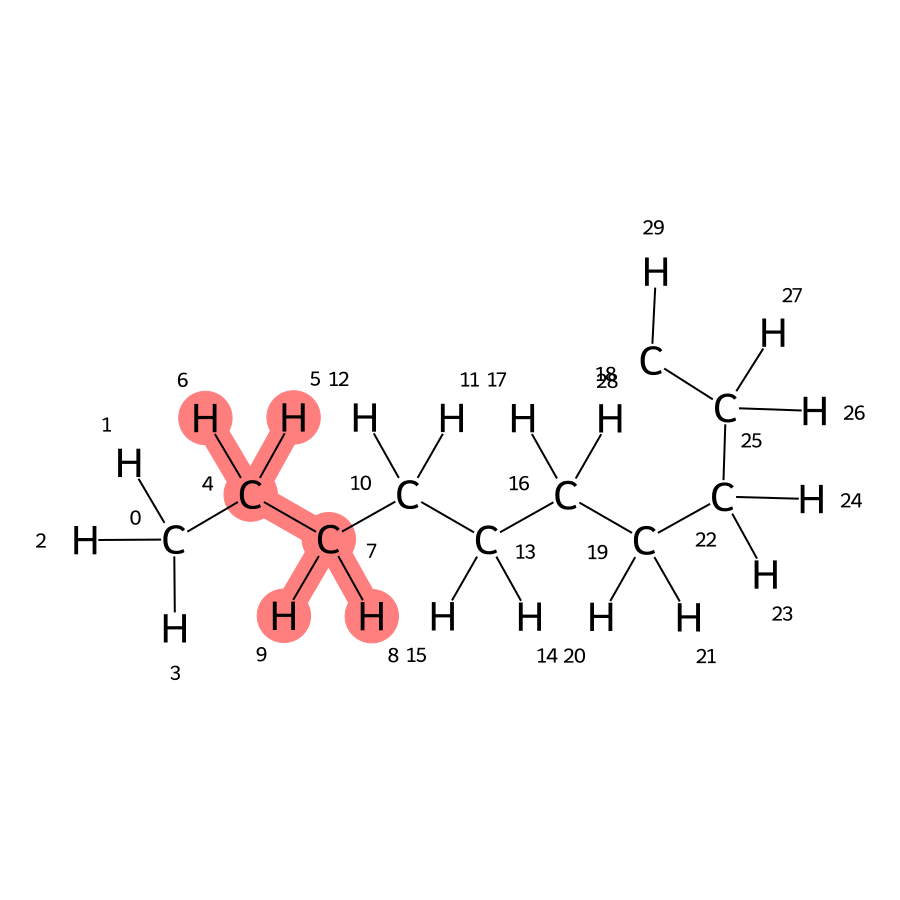

In [10]:
file = 'polymer_examples/rdkit_simple_polymers/polyethylene.pdb'
rdmol, new_smarts, smarts_block, selected_atoms, assigned_ids, unassigned_ids = create_smarts_substructure(file, 
                                                                           exclusive_wall_ids=[0,10], 
                                                                           seed=4, 
                                                                           inclusive_wall_ids=[], 
                                                                           sample_size=30,
                                                                           sample_seed=1)
print(smarts_block)
print(selected_atoms)
rdkit_visualize(rdmol, 900, 900, grey_highlight_ids=selected_atoms)

In [ ]:
mol = Molecule.from_pdb(file)


# PDB Reading for PE

In [ ]:
rdmol, new_smarts, smarts_block, selected_atoms = create_smarts_substructure(file, 
                                                                           exclusive_wall_ids=[20], 
                                                                           seed=4, 
                                                                           inclusive_wall_ids=[], 
                                                                           sample_size=-1,
                                                                           sample_seed=-1)
print(smarts_block)
print(selected_atoms)
rdkit_visualize(rdmol, 900, 900, show_3D=True, grey_highlight_ids=selected_atoms)

# PDB Reading for PAMAM

In [72]:
file = 'polymer_examples/rdkit_simple_polymers/PAMAM.pdb'

mol = Molecule.from_pdb(file)
rdmol = Chem.rdmolfiles.MolFromPDBFile(file)
assigned_atoms = set()
for atom in mol.atoms:
    if atom.metadata['already_matched']:
        assigned_atoms.add(atom.molecule_atom_index)
print(assigned_atoms)

PAMAM
[C:1](-[C:2](-[C:3](-[N:4](-[C:5](-[C:6](-[N:7](-[H:8])-[H:9])(-[H:10])-[H:11])(-[H:12])-[H:13])-[H:14])=[O:15])(-[H:16])-[H:17])(-[H:18])-[H:19]
PAMAM
[C:1](-[C:2](-[C:3](-[N:4](-[C:5](-[C:6](-[N:7])(-[H:8])-[H:9])(-[H:10])-[H:11])-[H:12])=[O:13])(-[H:14])-[H:15])(-[H:16])-[H:17]
POLYETHYLENE
[C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]
PEPTIDE_BOND
[C:1](=[O:2])[N:3]([C:4])
DEFAULT_MONOMER_BOND
[C:1]([H:3])([H:4])[C:2]([H:5])([H:6])
N. of assigned nodes: 514 -- N. of atoms: 530
N. of assigned edges: 542 -- N. of bonds: 529
0 {'atomic_number': 7, 'formal_charge': 0.0, 'atom_name': 'N', 'residue_name': 'UNL', 'residue_number': 0}
Formal charge: 0
1 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'C', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE', 'connors_residue_number': 1, 'connors_atom_name': 'C1'}
Formal charge: 0
2 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'C1', 'residue_name': 'UNL', 'residue_numbe

452 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'H3V', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PAMAM', 'connors_residue_number': 12, 'connors_atom_name': 'H3'}
Formal charge: 0
453 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'H3W', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PAMAM', 'connors_residue_number': 12, 'connors_atom_name': 'H4'}
Formal charge: 0
454 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'H3X', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PAMAM', 'connors_residue_number': 12, 'connors_atom_name': 'H1'}
Formal charge: 0
455 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'H3Y', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PAMAM', 'connors_residue_number': 12, 'connors_atom_name': 'H2'}
Formal charge: 0
456 {'atomic_number': 1, 'formal_cha

59:49] unrecognized bond type[21:59:49] unrecognized bond type[21:59:49] unrecognized bond type[21:59:49] unrecognized bond type[21:59:49] unrecognized bond type[21:59:49] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unr

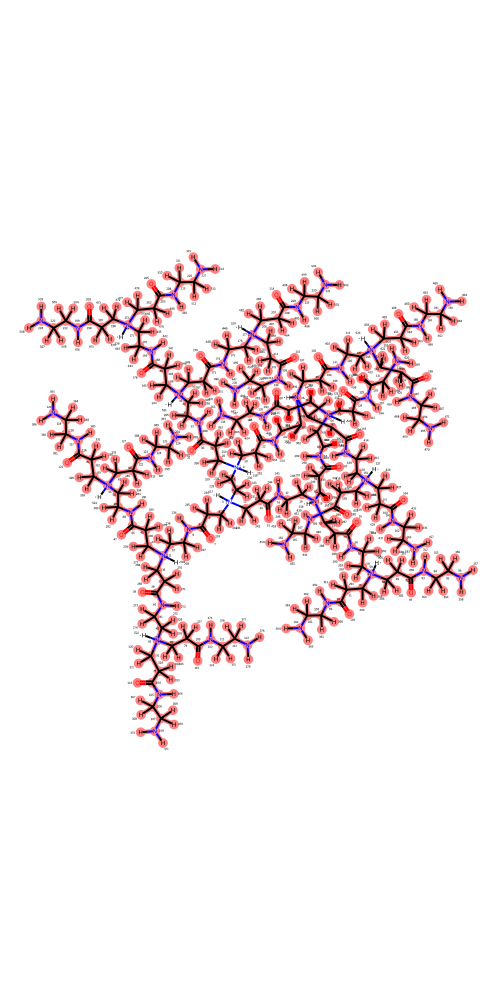

bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[22:00:59] unrecognized bond type[

In [73]:
mol.visualize(backend='rdkit', height=1000, highlight_ids=list(assigned_atoms))

molecule substructure is smaller than the specificed size of 800.
"[N&+:1](-[C:2](-[C:3](-[N&+:4](-[C:5](-[C:6](-[C:7](-[O:8])-[N:9](-[C:10](-[C:11](-[N&+:12](-[C:13](-[C:14](-[C:15](-[O:16])-[N:17](-[C:18](-[C:19](-[N&+:20](-[C:21](-[C:22](-[C:23](-[N:24](-[C:25](-[C:26](-[N:27](-[H:28])-[H:29])(-[H:30])-[H:31])(-[H:32])-[H:33])-[H:34])-[O:35])(-[H:36])-[H:37])(-[H:38])-[H:39])(-[C:40](-[C:41](-[C:42](-[N:43](-[C:44](-[C:45](-[N:46])(-[H:47])-[H:48])(-[H:49])-[H:50])-[H:51])-[O:52])(-[H:53])-[H:54])(-[H:55])-[H:56])-[H:57])(-[H:58])-[H:59])(-[H:60])-[H:61])-[H:62])(-[H:63])-[H:64])(-[H:65])-[H:66])(-[C:67](-[C:68](-[C:69](-[O:70])-[N:71](-[C:72](-[C:73](-[N&+:74](-[C:75](-[C:76](-[C:77](-[N:78](-[C:79](-[C:80](-[N:81](-[H:82])-[H:83])(-[H:84])-[H:85])(-[H:86])-[H:87])-[H:88])-[O:89])(-[H:90])-[H:91])(-[H:92])-[H:93])(-[C:94](-[C:95](-[C:96](-[N:97](-[C:98](-[C:99](-[N:100](-[H:101])-[H:102])(-[H:103])-[H:104])(-[H:105])-[H:106])-[H:107])-[O:108])(-[H:109])-[H:110])(-[H:111])-[H:112])-

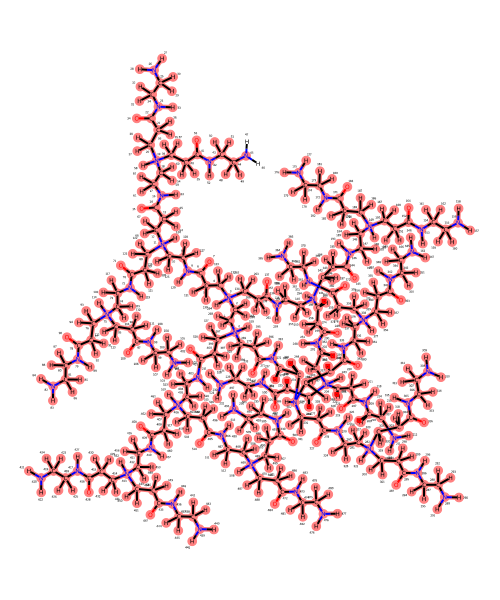

In [76]:
rdmol, new_smarts, smarts_block, selected_atoms = create_smarts_substructure(file, 
                                                                           exclusive_wall_ids=[], 
                                                                           seed=2, 
                                                                           inclusive_wall_ids=[45], 
                                                                           sample_size=800,
                                                                           sample_seed=1)
print(smarts_block)
print(selected_atoms)
rdkit_visualize(rdmol, 500, 600, grey_highlight_ids=selected_atoms)

# Vulcanized Rubber

In [32]:
file = 'polymer_examples/rdkit_simple_polymers/vulcanizedrubber.pdb'

mol = Molecule.from_pdb(file)
rdmol = Chem.rdmolfiles.MolFromPDBFile(file)
assigned_atoms = set()
for atom in mol.atoms:
    if atom.metadata['already_matched']:
        assigned_atoms.add(atom.molecule_atom_index)
print(assigned_atoms)

POLYETHYLENE
[C:1](-[C:2](-[H:3])-[H:4])(-[H:5])-[H:6]
DEFAULT_MONOMER_BOND
[C:1]([H:3])([H:4])[C:2]([H:5])([H:6])
N. of assigned nodes: 24 -- N. of atoms: 103
N. of assigned edges: 24 -- N. of bonds: 106
0 {'atomic_number': 6, 'formal_charge': 0.0, 'atom_name': 'C', 'residue_name': 'UNL', 'residue_number': 0}
Formal charge: 0
1 {'atomic_number': 6, 'formal_charge': 0.0, 'atom_name': 'C1', 'residue_name': 'UNL', 'residue_number': 0}
Formal charge: 0
2 {'atomic_number': 6, 'formal_charge': 0.0, 'atom_name': 'C2', 'residue_name': 'UNL', 'residue_number': 0}
Formal charge: 0
3 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'C3', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE', 'connors_residue_number': 1, 'connors_atom_name': 'C1'}
Formal charge: 0
4 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'C4', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'POLYETHYLENE', 'conno

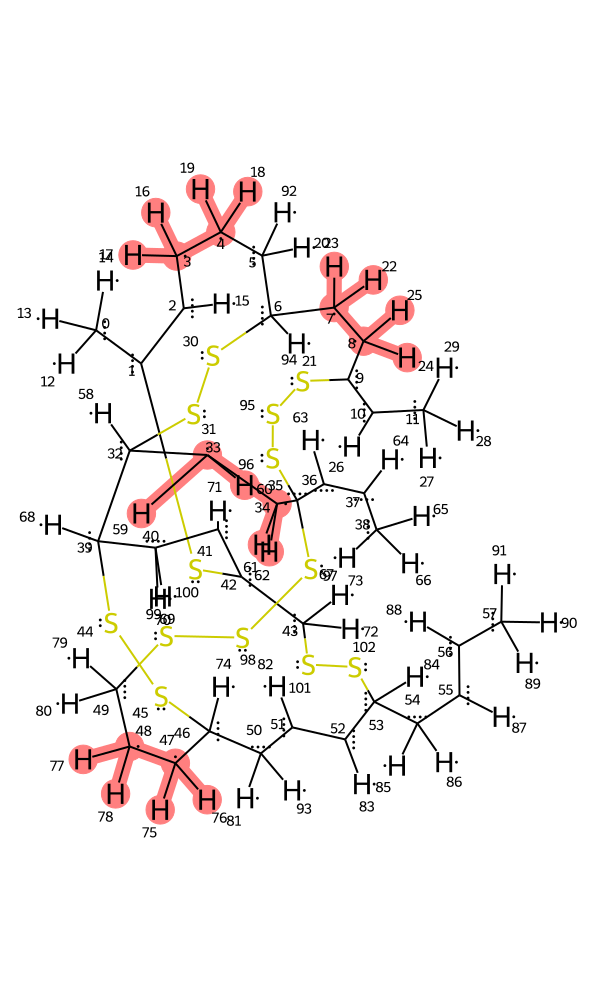

In [33]:
mol.visualize(backend='rdkit', height=1000, width=600, highlight_ids=list(assigned_atoms))

In [34]:
rdmol, new_smarts, smarts_block, selected_atoms = create_smarts_substructure(file, 
                                                                           exclusive_wall_ids=[17, 18], 
                                                                           seed=50, 
                                                                           inclusive_wall_ids=[], 
                                                                           sample_size=-1,
                                                                           sample_seed=-1)
print(smarts_block)
print(selected_atoms)
rdkit_visualize(rdmol, 900, 900, show_3D=True, grey_highlight_ids=selected_atoms)

"[C:1](-[C:2]1-[C:3](-[C:4](-[C:5](-[C:6](-[C:7]2(-[C:8](-[C:9](-[C:10](-[C:11](-[C:12](-[H:26])(-[H:27])-[H:28])-[H:25])-[S:93]-[S:94]-[S:95]-[C:34]3(-[C:33](-[C:32](-[C:31](-[S:30]-[S:29]-2)(-[C:38]2(-[C:39](-[C:40](-[C:41](-[C:42](-[H:71])(-[H:72])-[S:100]-[S:101]-[C:52](-[C:51](-[C:50](-[C:49](-[C:45](-[S:44]-[S:43]-2)(-[C:46](-[C:47](-[C:48](-[H:78])(-[H:79])-[S:98]-[S:97]-[S:96]-3)(-[H:76])-[H:77])(-[H:74])-[H:75])-[H:73])(-[H:80])-[H:92])-[H:81])-[H:82])(-[C:53](-[C:54](-[C:55](-[C:56](-[H:88])(-[H:89])-[H:90])-[H:87])-[H:86])(-[H:84])-[H:85])-[H:83])-[S:99]-1)-[H:70])(-[H:68])-[H:69])-[H:67])-[H:57])(-[H:58])-[H:59])(-[H:60])-[H:61])-[C:35](-[C:36](-[C:37](-[H:64])(-[H:65])-[H:66])-[H:63])-[H:62])(-[H:23])-[H:24])(-[H:21])-[H:22])-[H:20])(-[H:19])-[H:91])-[H:18])-[H:17])-[H:16])(-[H:13])(-[H:14])-[H:15]": [
	"C1",
	"C2",
	"C3",
	"C4",
	"C5",
	"C6",
	"C7",
	"C8",
	"C9",
	"C10",
	"C11",
	"C12",
	"H1",
	"H2",
	"H3",
	"H4",
	"S1",
	"S2",
	"S3",
	"C13",
	"C14",
	"C15",
	"C16",
	"S4"

NGLWidget()

# Looking at ALA_TPO.pdb

In [35]:
file = 'polymer_examples/simple_polymers/ALA_TPO.pdb'

mol = Molecule.from_pdb(file)
rdmol = Chem.rdmolfiles.MolFromPDBFile(file)
assigned_atoms = set()
for atom in mol.atoms:
    if atom.metadata['already_matched']:
        assigned_atoms.add(atom.molecule_atom_index)
print(assigned_atoms)

PhosphoTyrosine
[N:1](-[C@:2](-[H:3])(-[C:4](-[c:5]1=[c:6](-[c:7](=[c:8](-[O:9]-[P:10](=[O:11])(-[O-:12])-[O-:13])-[c:14](=[c:15]-1-[H:24])-[H:23])-[H:22])-[H:21])(-[H:19])-[H:20])-[C:16]-[O:17])-[H:18]
ALA
[N:1]([C@:2]([C:3]=[O:4])([C:5]([H:8])([H:9])[H:10])[H:7])[H:6]
ACE
[C:1](=[O:2])[C:3]([H:4])([H:5])[H:6]
NME
[N:1]([C:2]([H:4])([H:5])[H:6])[H:3]
PEPTIDE_BOND
[C:1](=[O:2])[N:3]([C:4])
N. of assigned nodes: 46 -- N. of atoms: 46
N. of assigned edges: 46 -- N. of bonds: 46
0 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'C1x', 'residue_name': '', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'ACE', 'connors_residue_number': 1, 'connors_atom_name': 'CH3'}
Formal charge: 0
1 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'C2x', 'residue_name': '', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'ACE', 'connors_residue_number': 1, 'connors_atom_name': 'C'}
Formal charge: 0
2 {'atomic_number': 8, 'formal_charge': 0, 'atom_name

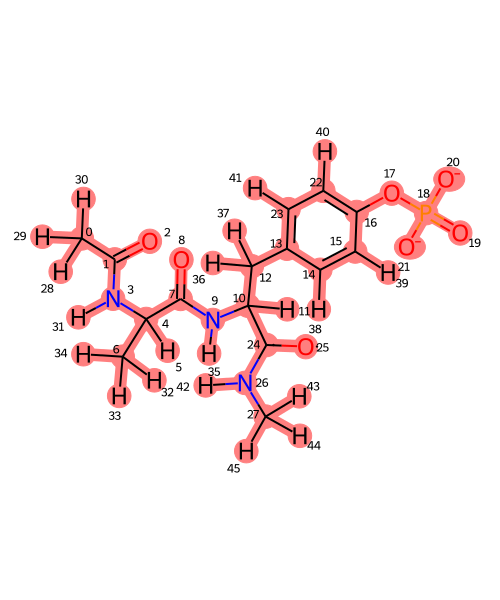

In [36]:
mol.visualize(backend='rdkit', height=600, highlight_ids=list(assigned_atoms))

"[N:1](-[C@:2](-[H:3])(-[C:4](-[C:5]1-[C:6](-[C:7](-[C:8](-[O:9]-[P:10](-[O:11])(-[O:12])-[O:13])-[C:14](-[C:15]-1-[H:24])-[H:23])-[H:22])-[H:21])(-[H:19])-[H:20])-[C:16]-[O:17])-[H:18]": [
	"N1",
	"C1",
	"H1",
	"C2",
	"C3",
	"C4",
	"C5",
	"C6",
	"O1",
	"P1",
	"O2",
	"O3",
	"O4",
	"C7",
	"C8",
	"H2",
	"H3",
	"H4",
	"H5",
	"H6",
	"H7",
	"C9",
	"O5",
	"H8"
]
[16, 17, 18, 20, 15, 19, 14, 13, 12, 10, 37, 11, 22, 39, 23, 9, 40, 35, 21, 36, 41, 38, 24, 25]


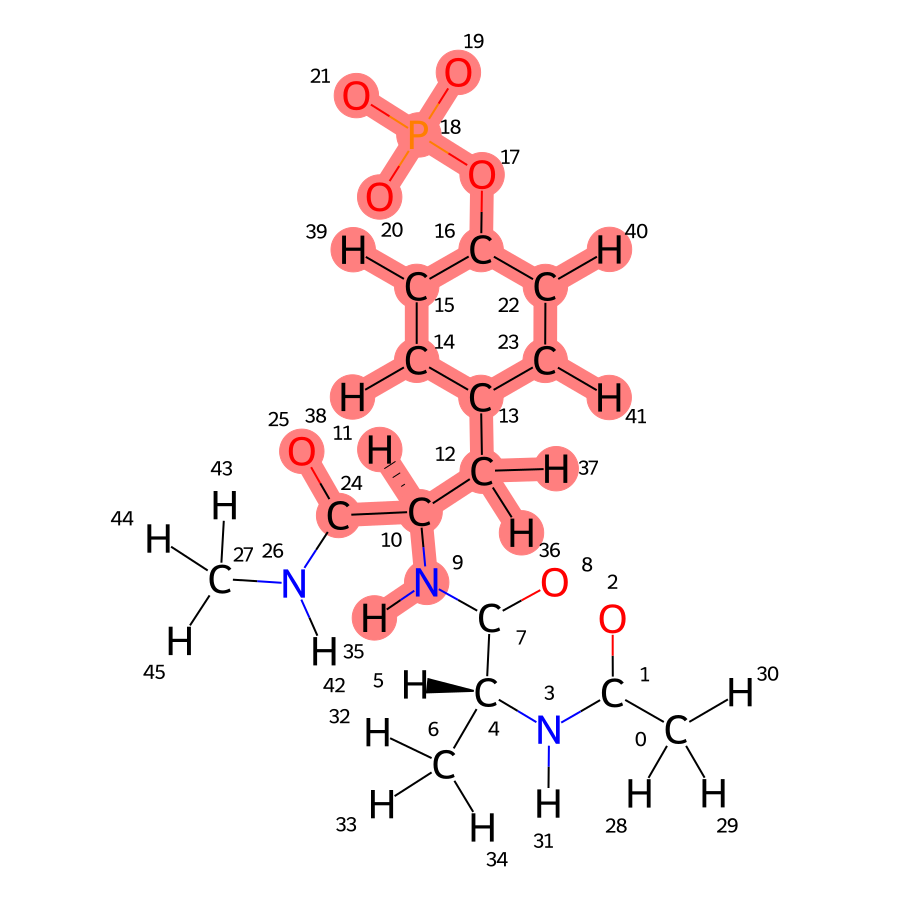

In [37]:
rdmol, new_smarts, smarts_block, selected_atoms = create_smarts_substructure(file, 
                                                                           exclusive_wall_ids=[26, 7], 
                                                                           seed=16, 
                                                                           inclusive_wall_ids=[], 
                                                                           sample_size=-1,
                                                                           sample_seed=-1)
print(smarts_block)
print(selected_atoms)
rdkit_visualize(rdmol, 900, 900, grey_highlight_ids=selected_atoms)


# Nate's Molecule

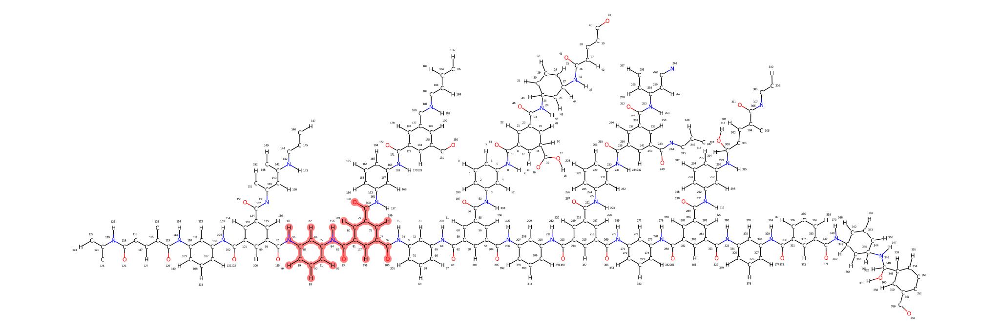

In [77]:
file = 'polymer_examples/rdkit_simple_polymers/polyamide_equil.pdb'
rdmol, new_smarts, smarts_block, selected_atoms = create_smarts_substructure(file, 
                                                                           exclusive_wall_ids=[97, 74, 161], 
                                                                           seed=95, 
                                                                           inclusive_wall_ids=[], 
                                                                           sample_size=400,
                                                                           sample_seed=1)
# print(smarts_block)
# print(selected_atoms)
rdkit_visualize(rdmol, 3000, 1000, grey_highlight_ids=selected_atoms)

"[H:1]-[C:2]1-[C:3](-[C:4](-[C:5](-[C:6](-[C:7]-1-[H:8])-[N:9](-[H:10])-[C:11](-[C:12]1-[C:13](-[H:14])-[C:15](-[C:16](-[O:17])-[O:18]-[H:19])(-[C:20](-[C:21](-[C:22]-1-[H:23])-[C:24]-[O:25])-[H:26])-[H:27])-[O:28])-[H:29])-[N:30]-[H:31])-[H:32]": [
	"H1",
	"C1",
	"C2",
	"C3",
	"C4",
	"C5",
	"C6",
	"H2",
	"N1",
	"H3",
	"C7",
	"C8",
	"C9",
	"H4",
	"C10",
	"C11",
	"O1",
	"O2",
	"H5",
	"C12",
	"C13",
	"C14",
	"H6",
	"C15",
	"O3",
	"H7",
	"H8",
	"O4",
	"H9",
	"N2",
	"H10",
	"H11"
]
[1, 2, 3, 4, 5, 8, 10, 51, 0, 399, 52, 11, 21, 20, 19, 14, 50, 6, 9, 22, 49, 7, 53, 23, 398, 12, 48, 15, 16, 13, 17, 18]


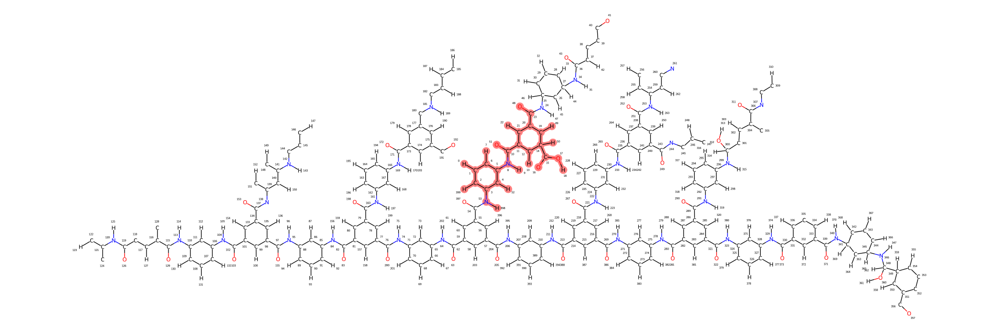

In [78]:
file = 'polymer_examples/rdkit_simple_polymers/polyamide_equil.pdb'
rdmol, new_smarts, smarts_block, selected_atoms = create_smarts_substructure(file, 
                                                                           exclusive_wall_ids=[54,24], 
                                                                           seed=1, 
                                                                           inclusive_wall_ids=[], 
                                                                           sample_size=400,
                                                                           sample_seed=1)
print(smarts_block)
print(selected_atoms)
rdkit_visualize(rdmol, 3000, 1000, grey_highlight_ids=selected_atoms)

"[C:1](-[C:2]1-[C:3](-[H:4])-[C:5](-[C:6]-[O:7])-[C:8](-[C:9](-[C:10]-1-[H:11])(-[C:12](-[N:13](-[C:14]1-[C:15](-[C:16](-[C:17](-[C:18](-[C:19]-1-[H:20])-[N:21]-[H:22])-[H:23])-[H:24])-[H:25])-[H:26])(-[O:27]-[H:28])-[H:29])-[H:30])-[H:31])-[O:32]": [
	"C1",
	"C2",
	"C3",
	"H1",
	"C4",
	"C5",
	"O1",
	"C6",
	"C7",
	"C8",
	"H2",
	"C9",
	"N1",
	"C10",
	"C11",
	"C12",
	"C13",
	"C14",
	"C15",
	"H3",
	"N2",
	"H4",
	"H5",
	"H6",
	"H7",
	"H8",
	"O2",
	"H9",
	"H10",
	"H11",
	"H12",
	"O3"
]


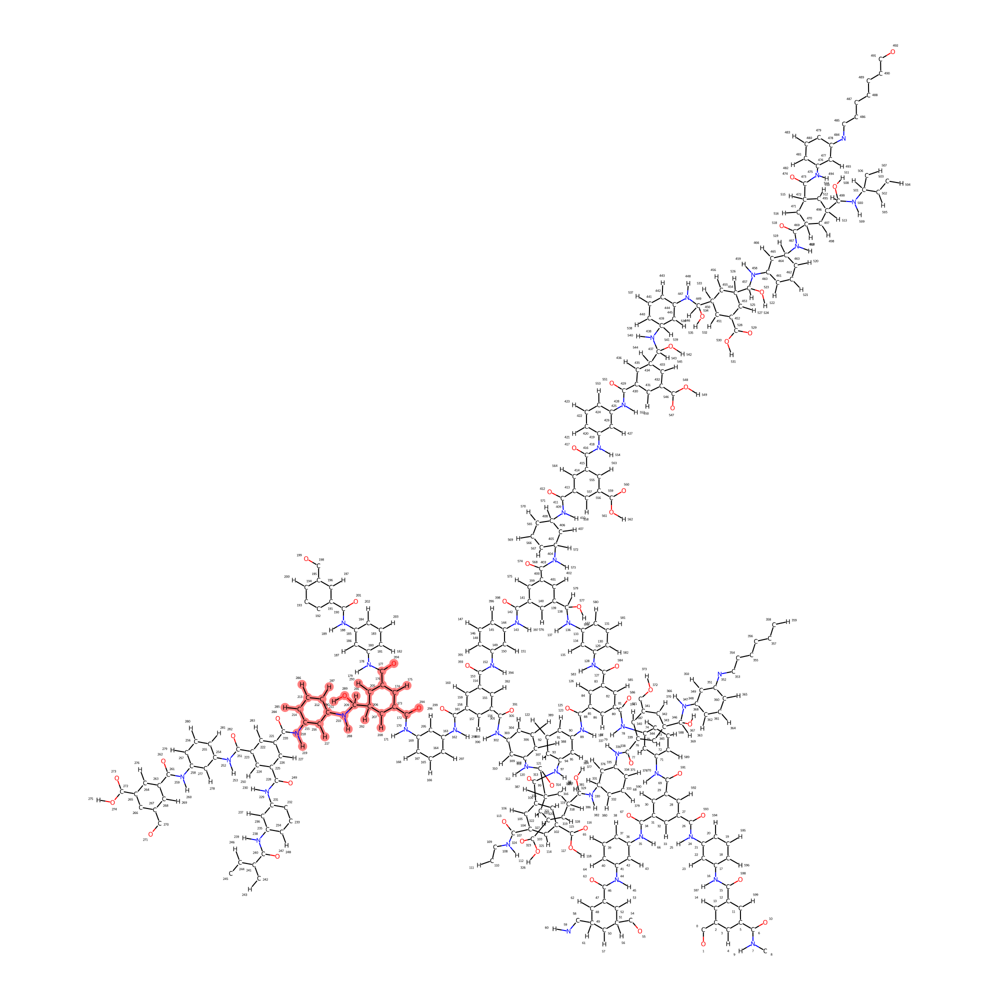

In [79]:
file = 'polymer_examples/rdkit_simple_polymers/polyamide_equil.pdb'
rdmol, new_smarts, smarts_block, selected_atoms = create_smarts_substructure(file, 
                                                                           exclusive_wall_ids=[220, 178, 170], 
                                                                           seed=211, 
                                                                           inclusive_wall_ids=[], 
                                                                           sample_size=600,
                                                                           sample_seed=6023)
print(smarts_block)
# print(selected_atoms)
rdkit_visualize(rdmol, 2000, 2000, grey_highlight_ids=selected_atoms)

"[N:1](-[C:2]1-[C:3](-[C:4](-[H:5])-[C:6](-[C:7](-[C:8]-1-[H:9])-[N:10]-[H:11])-[H:12])-[H:13])-[H:14]": [
	"N1",
	"C1",
	"C2",
	"C3",
	"H1",
	"C4",
	"C5",
	"C6",
	"H2",
	"N2",
	"H3",
	"H4",
	"H5",
	"H6"
]


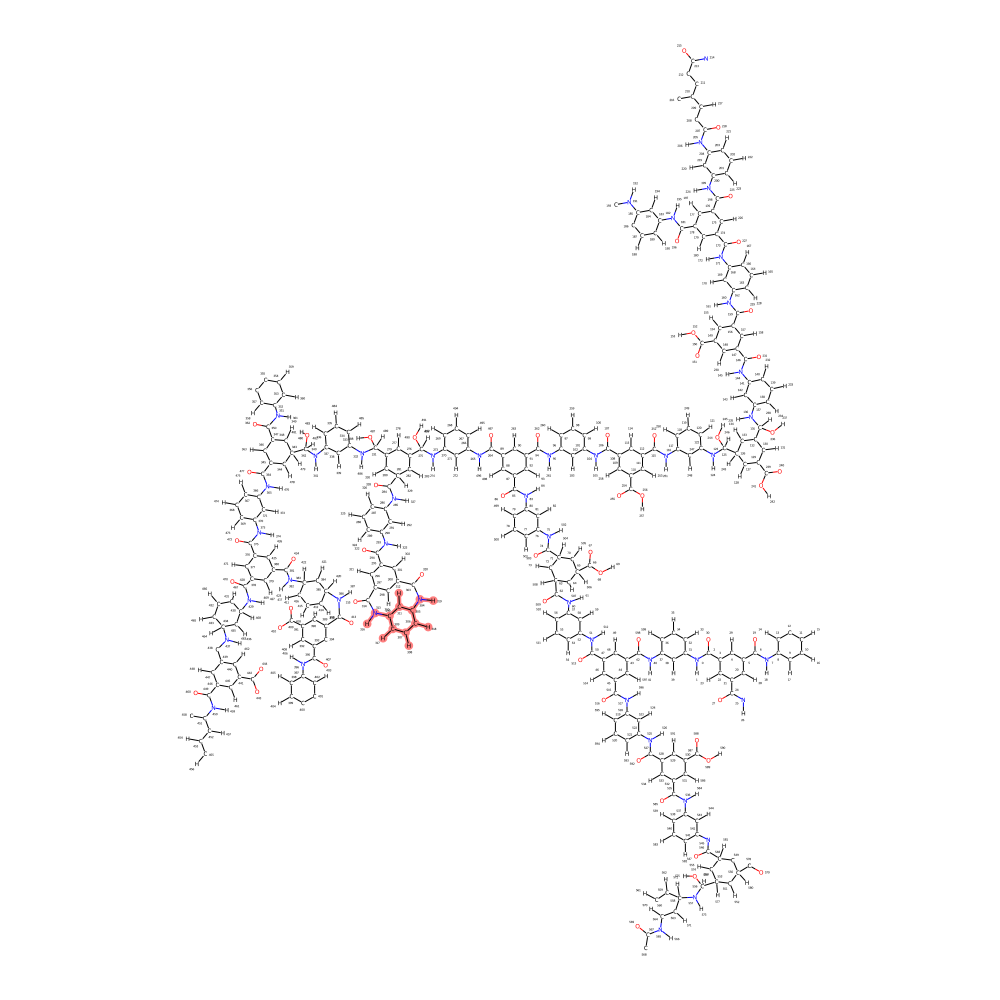

In [80]:
file = 'polymer_examples/rdkit_simple_polymers/polyamide_equil.pdb'
rdmol, new_smarts, smarts_block, selected_atoms = create_smarts_substructure(file, 
                                                                           exclusive_wall_ids=[303, 314], 
                                                                           seed=312, 
                                                                           inclusive_wall_ids=[], 
                                                                           sample_size=600,
                                                                           sample_seed=5000)
print(smarts_block)
# print(selected_atoms)
rdkit_visualize(rdmol, 2000, 2000, grey_highlight_ids=selected_atoms)

PolyAmide
[C:1](-[C:2]1-[C:3](-[H:4])-[C:5](-[C:6]-[O:7])-[C:8](-[C:9](-[C:10]-1-[H:11])(-[C:12](-[N:13](-[C:14]1-[C:15](-[C:16](-[C:17](-[C:18](-[C:19]-1-[H:20])-[N:21]-[H:22])-[H:23])-[H:24])-[H:25])-[H:26])(-[O:27]-[H:28])-[H:29])-[H:30])-[H:31])-[O:32]
PolyAmide
[H:1]-[C:2]1-[C:3](-[C:4](-[C:5](-[C:6](-[C:7]-1-[H:8])-[N:9](-[H:10])-[C:11](-[C:12]1-[C:13](-[H:14])-[C:15](-[C:16](-[O:17])-[O:18]-[H:19])(-[C:20](-[C:21](-[C:22]-1-[H:23])-[C:24]-[O:25])-[H:26])-[H:27])-[O:28])-[H:29])-[N:30]-[H:31])-[H:32]
PolyAmide
[N:1](-[C:2]1-[C:3](-[C:4](-[H:5])-[C:6](-[C:7](-[C:8]-1-[H:9])-[N:10]-[H:11])-[H:12])-[H:13])-[H:14]
PEPTIDE_BOND
[C:1](=[O:2])[N:3]([C:4])
N. of assigned nodes: 4160 -- N. of atoms: 6925
N. of assigned edges: 4289 -- N. of bonds: 7422
0 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'H', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 1, 'connors_atom_name': 'H1'}
Formal charge: 0
1

524 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'H3c', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 26, 'connors_atom_name': 'H5'}
Formal charge: 0
525 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'H3d', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 26, 'connors_atom_name': 'H2'}
Formal charge: 0
526 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'H3e', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 17, 'connors_atom_name': 'H5'}
Formal charge: 0
527 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'C3~', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 22, 'connors_atom_name': 'C4'}
Formal charge: 0
528 {'atomic_number'

Formal charge: 0
972 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'H4#', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 4, 'connors_atom_name': 'H11'}
Formal charge: 0
973 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'H4$', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 4, 'connors_atom_name': 'H1'}
Formal charge: 0
974 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'H4%', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 4, 'connors_atom_name': 'H2'}
Formal charge: 0
975 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'C6Z', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 3, 'connors_atom_name': 'C11'}
Formal charge: 0
976 {

1323 {'atomic_number': 6, 'formal_charge': 0.0, 'atom_name': 'C8Z', 'residue_name': 'UNL', 'residue_number': 0}
Formal charge: 0
1324 {'atomic_number': 6, 'formal_charge': 0.0, 'atom_name': 'C8!', 'residue_name': 'UNL', 'residue_number': 0}
Formal charge: 0
1325 {'atomic_number': 1, 'formal_charge': 0.0, 'atom_name': 'H6n', 'residue_name': 'UNL', 'residue_number': 0}
Formal charge: 0
1326 {'atomic_number': 1, 'formal_charge': 0.0, 'atom_name': 'H6o', 'residue_name': 'UNL', 'residue_number': 0}
Formal charge: 0
1327 {'atomic_number': 6, 'formal_charge': 0.0, 'atom_name': 'C8@', 'residue_name': 'UNL', 'residue_number': 0}
Formal charge: 0
1328 {'atomic_number': 6, 'formal_charge': 0.0, 'atom_name': 'C8#', 'residue_name': 'UNL', 'residue_number': 0}
Formal charge: 0
1329 {'atomic_number': 8, 'formal_charge': 0.0, 'atom_name': 'O2R', 'residue_name': 'UNL', 'residue_number': 0}
Formal charge: 0
1330 {'atomic_number': 8, 'formal_charge': 0.0, 'atom_name': 'O2S', 'residue_name': 'UNL', 'resid

Formal charge: 0
1689 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'H7!', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 61, 'connors_atom_name': 'H4'}
Formal charge: 0
1690 {'atomic_number': 7, 'formal_charge': 0, 'atom_name': 'N2J', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 61, 'connors_atom_name': 'N2'}
Formal charge: 0
1691 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'H7@', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 61, 'connors_atom_name': 'H2'}
Formal charge: 0
1692 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'H7#', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 61, 'connors_atom_name': 'H3'}
Formal charge: 0

2139 {'atomic_number': 6, 'formal_charge': 0.0, 'atom_name': 'CdK', 'residue_name': 'UNL', 'residue_number': 0}
Formal charge: 0
2140 {'atomic_number': 6, 'formal_charge': 0.0, 'atom_name': 'CdL', 'residue_name': 'UNL', 'residue_number': 0}
Formal charge: 0
2141 {'atomic_number': 6, 'formal_charge': 0.0, 'atom_name': 'CdM', 'residue_name': 'UNL', 'residue_number': 0}
Formal charge: 0
2142 {'atomic_number': 1, 'formal_charge': 0.0, 'atom_name': 'H9J', 'residue_name': 'UNL', 'residue_number': 0}
Formal charge: 0
2143 {'atomic_number': 6, 'formal_charge': 0.0, 'atom_name': 'CdN', 'residue_name': 'UNL', 'residue_number': 0}
Formal charge: 0
2144 {'atomic_number': 6, 'formal_charge': 0.0, 'atom_name': 'CdO', 'residue_name': 'UNL', 'residue_number': 0}
Formal charge: 0
2145 {'atomic_number': 8, 'formal_charge': 0.0, 'atom_name': 'O3G', 'residue_name': 'UNL', 'residue_number': 0}
Formal charge: 0
2146 {'atomic_number': 8, 'formal_charge': 0.0, 'atom_name': 'O3H', 'residue_name': 'UNL', 'resid

Formal charge: 0
2618 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'Cgz', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 64, 'connors_atom_name': 'C4'}
Formal charge: 0
2619 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'Cgy', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 64, 'connors_atom_name': 'C1'}
Formal charge: 0
2620 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'CgA', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 64, 'connors_atom_name': 'C6'}
Formal charge: 0
2621 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'CgB', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 64, 'connors_atom_name': 'C5'}
Formal charge: 0

3115 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'Hdi', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 113, 'connors_atom_name': 'H4'}
Formal charge: 0
3116 {'atomic_number': 7, 'formal_charge': 0, 'atom_name': 'N3^', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 113, 'connors_atom_name': 'N2'}
Formal charge: 0
3117 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'Hdj', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 113, 'connors_atom_name': 'H3'}
Formal charge: 0
3118 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'Cjm', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 119, 'connors_atom_name': 'C4'}
Formal charge: 0
3119 {'atomi

Formal charge: 0
3422 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'Hey', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 95, 'connors_atom_name': 'H1'}
Formal charge: 0
3423 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'Cl5', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 123, 'connors_atom_name': 'C4'}
Formal charge: 0
3424 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'Cl6', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 123, 'connors_atom_name': 'C3'}
Formal charge: 0
3425 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'Cl7', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 123, 'connors_atom_name': 'C2'}
Formal charge

3774 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'Hf!', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 136, 'connors_atom_name': 'H6'}
Formal charge: 0
3775 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'Hf@', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 9, 'connors_atom_name': 'H7'}
Formal charge: 0
3776 {'atomic_number': 7, 'formal_charge': 0, 'atom_name': 'N4u', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 9, 'connors_atom_name': 'N1'}
Formal charge: 0
3777 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'Hf#', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 9, 'connors_atom_name': 'H8'}
Formal charge: 0
3778 {'atomic_numb

4143 {'atomic_number': 8, 'formal_charge': 0, 'atom_name': 'O6a', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 13, 'connors_atom_name': 'O2'}
Formal charge: 0
4144 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'Hhj', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 172, 'connors_atom_name': 'H4'}
Formal charge: 0
4145 {'atomic_number': 7, 'formal_charge': 0, 'atom_name': 'N4V', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 28, 'connors_atom_name': 'N1'}
Formal charge: 0
4146 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'Hhk', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 28, 'connors_atom_name': 'H3'}
Formal charge: 0
4147 {'atomic_n

4613 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'Hj5', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 135, 'connors_atom_name': 'H3'}
Formal charge: 0
4614 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'Cs4', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 161, 'connors_atom_name': 'C2'}
Formal charge: 0
4615 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'Cs5', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 161, 'connors_atom_name': 'C5'}
Formal charge: 0
4616 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'Cs6', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 161, 'connors_atom_name': 'C6'}
Formal charge: 0
4617 {'atomi

4993 {'atomic_number': 1, 'formal_charge': 0.0, 'atom_name': 'HkH', 'residue_name': 'UNL', 'residue_number': 0}
Formal charge: 0
4994 {'atomic_number': 1, 'formal_charge': 0.0, 'atom_name': 'HkI', 'residue_name': 'UNL', 'residue_number': 0}
Formal charge: 0
4995 {'atomic_number': 6, 'formal_charge': 0.0, 'atom_name': 'Cus', 'residue_name': 'UNL', 'residue_number': 0}
Formal charge: 0
4996 {'atomic_number': 6, 'formal_charge': 0.0, 'atom_name': 'Cut', 'residue_name': 'UNL', 'residue_number': 0}
Formal charge: 0
4997 {'atomic_number': 6, 'formal_charge': 0.0, 'atom_name': 'Cuu', 'residue_name': 'UNL', 'residue_number': 0}
Formal charge: 0
4998 {'atomic_number': 8, 'formal_charge': 0.0, 'atom_name': 'O7h', 'residue_name': 'UNL', 'residue_number': 0}
Formal charge: 0
4999 {'atomic_number': 8, 'formal_charge': 0.0, 'atom_name': 'O7i', 'residue_name': 'UNL', 'residue_number': 0}
Formal charge: 0
5000 {'atomic_number': 8, 'formal_charge': 0.0, 'atom_name': 'O7j', 'residue_name': 'UNL', 'resid

5405 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'Hm5', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 19, 'connors_atom_name': 'H4'}
Formal charge: 0
5406 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'Cw#', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 82, 'connors_atom_name': 'C4'}
Formal charge: 0
5407 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'Cw$', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 82, 'connors_atom_name': 'C3'}
Formal charge: 0
5408 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'Cw%', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 82, 'connors_atom_name': 'C5'}
Formal charge: 0
5409 {'atomic_nu

5796 {'atomic_number': 1, 'formal_charge': 0.0, 'atom_name': 'HnT', 'residue_name': 'UNL', 'residue_number': 0}
Formal charge: 0
5797 {'atomic_number': 8, 'formal_charge': 0.0, 'atom_name': 'O8h', 'residue_name': 'UNL', 'residue_number': 0}
Formal charge: 0
5798 {'atomic_number': 6, 'formal_charge': 0.0, 'atom_name': 'Cz~', 'residue_name': 'UNL', 'residue_number': 0}
Formal charge: 0
5799 {'atomic_number': 6, 'formal_charge': 0.0, 'atom_name': 'Cy1', 'residue_name': 'UNL', 'residue_number': 0}
Formal charge: 0
5800 {'atomic_number': 6, 'formal_charge': 0.0, 'atom_name': 'Cy2', 'residue_name': 'UNL', 'residue_number': 0}
Formal charge: 0
5801 {'atomic_number': 6, 'formal_charge': 0.0, 'atom_name': 'Cy3', 'residue_name': 'UNL', 'residue_number': 0}
Formal charge: 0
5802 {'atomic_number': 6, 'formal_charge': 0.0, 'atom_name': 'Cy4', 'residue_name': 'UNL', 'residue_number': 0}
Formal charge: 0
5803 {'atomic_number': 6, 'formal_charge': 0.0, 'atom_name': 'Cy5', 'residue_name': 'UNL', 'resid

Formal charge: 0
5962 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'Hoq', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 36, 'connors_atom_name': 'H4'}
Formal charge: 0
5963 {'atomic_number': 7, 'formal_charge': 0, 'atom_name': 'N6s', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 202, 'connors_atom_name': 'N1'}
Formal charge: 0
5964 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'Hor', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 202, 'connors_atom_name': 'H2'}
Formal charge: 0
5965 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'Hos', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 202, 'connors_atom_name': 'H6'}
Formal charge

6244 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'CBL', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 27, 'connors_atom_name': 'C8'}
Formal charge: 0
6245 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'CBM', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 27, 'connors_atom_name': 'C7'}
Formal charge: 0
6246 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'CBN', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 27, 'connors_atom_name': 'C6'}
Formal charge: 0
6247 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'CBO', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 27, 'connors_atom_name': 'C2'}
Formal charge: 0
6248 {'atomic_nu

6443 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'CC$', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 34, 'connors_atom_name': 'C14'}
Formal charge: 0
6444 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'CC%', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 34, 'connors_atom_name': 'C15'}
Formal charge: 0
6445 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'CC^', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 34, 'connors_atom_name': 'C10'}
Formal charge: 0
6446 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'Hqh', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 34, 'connors_atom_name': 'H5'}
Formal charge: 0
6447 {'atomic

Formal charge: 0
6678 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'Hrc', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 39, 'connors_atom_name': 'H1'}
Formal charge: 0
6679 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'CEe', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 39, 'connors_atom_name': 'C1'}
Formal charge: 0
6680 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'CEf', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 39, 'connors_atom_name': 'C9'}
Formal charge: 0
6681 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'CEg', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 39, 'connors_atom_name': 'C5'}
Formal charge: 0

Formal charge: 0
6902 {'atomic_number': 1, 'formal_charge': 0.0, 'atom_name': 'HtU', 'residue_name': 'UNL', 'residue_number': 0}
Formal charge: 0
6903 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'HtV', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 37, 'connors_atom_name': 'H11'}
Formal charge: 0
6904 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'HtW', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 37, 'connors_atom_name': 'H10'}
Formal charge: 0
6905 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'HtX', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 37, 'connors_atom_name': 'H9'}
Formal charge: 0
6906 {'atomic_number': 1, 'formal_charge': 0.0, 'atom_name': 'HtY', 'residue_name': 'UNL', 'residue_number': 0}
Fo

(392, 393) {'bond_order': 1}
(392, 430) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(394, 551) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(395, 396) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(395, 401) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(395, 556) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(396, 398) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(396, 399) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(397, 398) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(397, 557) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(398, 400) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(400, 402) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(401, 403) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(401, 560) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(403, 404) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(405, 406) {'bond_order': rdkit.Chem.rdchem.Bon

(721, 6722) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(724, 725) {'bond_order': 1}
(726, 728) {'bond_order': 1}
(726, 780) {'bond_order': 1}
(726, 1660) {'bond_order': 1}
(727, 780) {'bond_order': 1}
(728, 729) {'bond_order': 1}
(728, 765) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(730, 731) {'bond_order': 1}
(730, 732) {'bond_order': 1}
(731, 1671) {'bond_order': 1}
(733, 734) {'bond_order': 1}
(733, 737) {'bond_order': 1}
(733, 3415) {'bond_order': 1}
(734, 736) {'bond_order': 1}
(734, 738) {'bond_order': 1}
(735, 736) {'bond_order': 1}
(735, 740) {'bond_order': 1}
(735, 3416) {'bond_order': 1}
(736, 739) {'bond_order': 1}
(739, 741) {'bond_order': 1}
(739, 776) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(742, 743) {'bond_order': 1}
(742, 746) {'bond_order': 1}
(743, 745) {'bond_order': 1}
(743, 747) {'bond_order': 1}
(744, 745) {'bond_order': 1}
(744, 749) {'bond_order': 1}
(745, 748) {'bond_order': 1}
(748, 750) {'bond_order': 1}
(748, 755) {'b

(1327, 1330) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(1328, 1329) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(1328, 1331) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(1331, 1332) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(1333, 1334) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(1335, 1337) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(1338, 1339) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(1338, 1340) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(1339, 1341) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(1341, 1342) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(1343, 1345) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(1343, 4741) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(1343, 4742) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(1344, 1347) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(1344, 4741) {'bond_order': rdkit.Chem.rdchem.Bo

(1677, 1679) {'bond_order': 1}
(1677, 1700) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(1680, 1722) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(1680, 1754) {'bond_order': 1}
(1680, 2619) {'bond_order': 1}
(1681, 1755) {'bond_order': 1}
(1682, 1683) {'bond_order': 1}
(1682, 1710) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(1682, 1758) {'bond_order': 1}
(1684, 1685) {'bond_order': 1}
(1684, 1688) {'bond_order': 1}
(1685, 1687) {'bond_order': 1}
(1685, 1689) {'bond_order': 1}
(1686, 1687) {'bond_order': 1}
(1686, 1691) {'bond_order': 1}
(1687, 1690) {'bond_order': 1}
(1690, 1692) {'bond_order': 1}
(1690, 1711) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(1693, 1694) {'bond_order': 1}
(1693, 1766) {'bond_order': 1}
(1693, 1768) {'bond_order': 1}
(1694, 1695) {'bond_order': 1}
(1694, 1736) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(1696, 1698) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(1696, 1699) {'bond_order': rdkit.

(2060, 2061) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(2063, 2064) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(2066, 2067) {'bond_order': 1}
(2066, 2069) {'bond_order': 1}
(2067, 2068) {'bond_order': 1}
(2068, 2071) {'bond_order': 1}
(2068, 2072) {'bond_order': 1}
(2069, 2070) {'bond_order': 1}
(2070, 2071) {'bond_order': 1}
(2070, 2074) {'bond_order': 1}
(2071, 2073) {'bond_order': 1}
(2073, 2075) {'bond_order': 1}
(2073, 2124) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(2076, 2078) {'bond_order': 1}
(2076, 2079) {'bond_order': 1}
(2076, 5407) {'bond_order': 1}
(2077, 2078) {'bond_order': 1}
(2077, 2081) {'bond_order': 1}
(2077, 5408) {'bond_order': 1}
(2078, 2080) {'bond_order': 1}
(2080, 2126) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(2080, 2534) {'bond_order': 1}
(2082, 3070) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(2083, 2084) {'bond_order': 1}
(2083, 2086) {'bond_order': 1}
(2083, 2089) {'bond_order': 1}
(2084, 20

(2671, 2675) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(2672, 2673) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(2676, 2708) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(2676, 2790) {'bond_order': 1}
(2676, 2792) {'bond_order': 1}
(2678, 2679) {'bond_order': 1}
(2678, 2681) {'bond_order': 1}
(2678, 2684) {'bond_order': 1}
(2679, 2680) {'bond_order': 1}
(2679, 2685) {'bond_order': 1}
(2680, 2683) {'bond_order': 1}
(2680, 2686) {'bond_order': 1}
(2681, 2682) {'bond_order': 1}
(2681, 2688) {'bond_order': 1}
(2682, 2683) {'bond_order': 1}
(2682, 2689) {'bond_order': 1}
(2683, 2687) {'bond_order': 1}
(2687, 2690) {'bond_order': 1}
(2687, 2697) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(2688, 2731) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(2688, 6012) {'bond_order': 1}
(2691, 2692) {'bond_order': 1}
(2691, 2694) {'bond_order': 1}
(2691, 2812) {'bond_order': 1}
(2691, 6755) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(26

(3098, 3100) {'bond_order': 1}
(3098, 3132) {'bond_order': 1}
(3101, 3102) {'bond_order': 1}
(3101, 3103) {'bond_order': 1}
(3101, 3104) {'bond_order': 1}
(3102, 3105) {'bond_order': 1}
(3102, 3253) {'bond_order': 1}
(3103, 3106) {'bond_order': 1}
(3103, 3254) {'bond_order': 1}
(3103, 6775) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(3106, 3138) {'bond_order': 1}
(3107, 3108) {'bond_order': 1}
(3107, 3260) {'bond_order': 1}
(3109, 3110) {'bond_order': 1}
(3109, 3260) {'bond_order': 1}
(3109, 3298) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(3111, 3112) {'bond_order': 1}
(3111, 3114) {'bond_order': 1}
(3112, 3113) {'bond_order': 1}
(3112, 3115) {'bond_order': 1}
(3113, 3116) {'bond_order': 1}
(3116, 3117) {'bond_order': 1}
(3116, 3135) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(3118, 3119) {'bond_order': 1}
(3118, 3121) {'bond_order': 1}
(3118, 3124) {'bond_order': 1}
(3119, 3120) {'bond_order': 1}
(3119, 3125) {'bond_order': 1}
(3120, 3123) {'bond_o

(3471, 3475) {'bond_order': 1}
(3471, 3492) {'bond_order': 1}
(3472, 3474) {'bond_order': 1}
(3472, 3504) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(3476, 3477) {'bond_order': 1}
(3476, 3479) {'bond_order': 1}
(3476, 3482) {'bond_order': 1}
(3477, 3478) {'bond_order': 1}
(3477, 3483) {'bond_order': 1}
(3478, 3481) {'bond_order': 1}
(3478, 3484) {'bond_order': 1}
(3479, 3480) {'bond_order': 1}
(3479, 3579) {'bond_order': 1}
(3480, 3481) {'bond_order': 1}
(3480, 3485) {'bond_order': 1}
(3486, 3487) {'bond_order': 1}
(3486, 3490) {'bond_order': 1}
(3486, 4192) {'bond_order': 1}
(3487, 3488) {'bond_order': 1}
(3487, 3492) {'bond_order': 1}
(3487, 6792) {'bond_order': 1}
(3488, 3489) {'bond_order': 1}
(3488, 3491) {'bond_order': 1}
(3489, 3493) {'bond_order': 1}
(3489, 4193) {'bond_order': 1}
(3492, 3494) {'bond_order': 1}
(3492, 6793) {'bond_order': 1}
(3493, 3610) {'bond_order': 1}
(3494, 6794) {'bond_order': 1}
(3496, 3497) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFI

(3702, 4451) {'bond_order': 1}
(3703, 3704) {'bond_order': 1}
(3703, 3708) {'bond_order': 1}
(3704, 3705) {'bond_order': 1}
(3704, 3709) {'bond_order': 1}
(3705, 3707) {'bond_order': 1}
(3707, 3711) {'bond_order': 1}
(3707, 3761) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(3708, 3710) {'bond_order': 1}
(3708, 3737) {'bond_order': 1}
(3712, 3713) {'bond_order': 1}
(3712, 3714) {'bond_order': 1}
(3712, 4472) {'bond_order': 1}
(3713, 3715) {'bond_order': 1}
(3713, 3885) {'bond_order': 1}
(3716, 3719) {'bond_order': 1}
(3716, 3720) {'bond_order': 1}
(3716, 3888) {'bond_order': 1}
(3717, 3718) {'bond_order': 1}
(3717, 3887) {'bond_order': 1}
(3717, 4612) {'bond_order': 1}
(3718, 3719) {'bond_order': 1}
(3718, 3722) {'bond_order': 1}
(3719, 3721) {'bond_order': 1}
(3721, 3723) {'bond_order': 1}
(3721, 3751) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(3724, 3725) {'bond_order': 1}
(3724, 3727) {'bond_order': 1}
(3725, 3726) {'bond_order': 1}
(3725, 3728) {'bond_order':

(4033, 4060) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(4036, 4145) {'bond_order': 1}
(4038, 4039) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(4040, 4041) {'bond_order': 1}
(4040, 4042) {'bond_order': 1}
(4040, 4045) {'bond_order': 1}
(4041, 4148) {'bond_order': 1}
(4041, 4158) {'bond_order': 1}
(4041, 6825) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(4042, 4043) {'bond_order': 1}
(4042, 4047) {'bond_order': 1}
(4043, 4044) {'bond_order': 1}
(4043, 4046) {'bond_order': 1}
(4044, 4148) {'bond_order': 1}
(4044, 4150) {'bond_order': 1}
(4044, 6826) {'bond_order': 1}
(4047, 4048) {'bond_order': 1}
(4049, 4052) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(4049, 4053) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(4049, 4796) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(4050, 4051) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(4050, 4152) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(4050, 4795) {'bond_or

(4552, 4554) {'bond_order': 1}
(4552, 4555) {'bond_order': 1}
(4553, 4556) {'bond_order': 1}
(4554, 4557) {'bond_order': 1}
(4557, 4558) {'bond_order': 1}
(4559, 4560) {'bond_order': 1}
(4559, 4562) {'bond_order': 1}
(4559, 4565) {'bond_order': 1}
(4560, 4561) {'bond_order': 1}
(4561, 4564) {'bond_order': 1}
(4562, 4563) {'bond_order': 1}
(4562, 4566) {'bond_order': 1}
(4563, 4564) {'bond_order': 1}
(4563, 4567) {'bond_order': 1}
(4566, 4568) {'bond_order': 1}
(4566, 4586) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(4569, 4570) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(4569, 4571) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(4569, 4720) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(4570, 4719) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(4570, 5436) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(4572, 5436) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(4573, 4576) {'bond_order': rdkit.Chem.rdchem.BondType.UNSP

(5148, 5169) {'bond_order': 1}
(5149, 5151) {'bond_order': 1}
(5149, 6013) {'bond_order': 1}
(5149, 6014) {'bond_order': 1}
(5150, 5153) {'bond_order': 1}
(5150, 6013) {'bond_order': 1}
(5151, 5152) {'bond_order': 1}
(5151, 5154) {'bond_order': 1}
(5152, 5153) {'bond_order': 1}
(5152, 5155) {'bond_order': 1}
(5154, 5156) {'bond_order': 1}
(5154, 5189) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(5157, 5158) {'bond_order': 1}
(5157, 5173) {'bond_order': 1}
(5159, 5160) {'bond_order': 1}
(5160, 5198) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(5161, 5162) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(5161, 5163) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(5161, 5303) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(5162, 5967) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(5162, 6162) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(5164, 5308) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(5165, 5166) {'bond_or

(5586, 5590) {'bond_order': 1}
(5586, 5808) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(5587, 5589) {'bond_order': 1}
(5587, 5637) {'bond_order': 1}
(5591, 5592) {'bond_order': 1}
(5591, 5651) {'bond_order': 1}
(5594, 5595) {'bond_order': 1}
(5594, 5597) {'bond_order': 1}
(5594, 5600) {'bond_order': 1}
(5595, 5596) {'bond_order': 1}
(5596, 5599) {'bond_order': 1}
(5596, 5601) {'bond_order': 1}
(5597, 5598) {'bond_order': 1}
(5597, 5603) {'bond_order': 1}
(5598, 5599) {'bond_order': 1}
(5598, 5604) {'bond_order': 1}
(5599, 5602) {'bond_order': 1}
(5602, 5606) {'bond_order': 1}
(5602, 5642) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(5603, 5605) {'bond_order': 1}
(5603, 5634) {'bond_order': 1}
(5607, 5608) {'bond_order': 1}
(5607, 5610) {'bond_order': 1}
(5607, 5613) {'bond_order': 1}
(5608, 5609) {'bond_order': 1}
(5608, 5614) {'bond_order': 1}
(5609, 5612) {'bond_order': 1}
(5609, 5615) {'bond_order': 1}
(5610, 5611) {'bond_order': 1}
(5611, 5612) {'bond_order':

(5908, 5909) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(5909, 5910) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(5909, 5912) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(5910, 5913) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(5913, 5915) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(5914, 5916) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(5916, 5917) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(5919, 5921) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(5922, 5923) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(5922, 5924) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(5922, 6686) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(5923, 5925) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(5925, 5926) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(5930, 5931) {'bond_order': 1}
(5930, 5932) {'bond_order': 1}
(5930, 5933) {'bond_order': 1}
(5931, 5934) {'bond_ord

(6477, 6478) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(6477, 6480) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(6477, 6483) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(6478, 6479) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(6478, 6485) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(6479, 6482) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(6479, 6484) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(6480, 6481) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(6481, 6482) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(6485, 6486) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(6487, 6489) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(6487, 6647) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(6487, 6648) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(6487, 6908) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(6488, 6648) {'bond_order': rdkit.Chem.rdchem.Bo

"[C:5711](-[H:5713])-[C:6546]1-[C:5715](-[O:5716])-[N:6576](-[C:6570](-[C:6567](-[H:6491])-[C:6568]-[H:6573])-[C:6571](-[C:6572]-[N:6575](-[H:6579])-[C:6645](-[C:6636]2-[C:6635](-[C:6638](-[C:6639](-[H:6560])-[C:6640](-[C:6637]-2-[H:6642])-[C:6644](-[O:6561])-[N:6595](-[C:6594]-[C:6514]-[H:6515])-[H:6596])(-[C:6643](-[N:6670](-[C:6529]2(-[C:6526](-[C:6525](-[C:6524](-[C:6527](-[C:6528]-2-[H:6534])(-[N:6533](-[H:6535])-[C:6551](-[C:6547](-[C:6545]-1-[H:6549])-[C:6548]-[H:6550])-[O:6552])-[H:6909])-[H:6530])-[H:6531])-[H:6532])-[H:6910])-[H:6671])(-[O:6692]-[H:6924])-[H:6919])-[H:6918])-[H:6641])-[O:6646])-[H:6577])-[H:6578]": [
	"C1",
	"H1",
	"C2",
	"C3",
	"O1",
	"N1",
	"C4",
	"C5",
	"H2",
	"C6",
	"H3",
	"C7",
	"C8",
	"N2",
	"H4",
	"C9",
	"C10",
	"C11",
	"C12",
	"C13",
	"H5",
	"C14",
	"C15",
	"H6",
	"C16",
	"O2",
	"N3",
	"C17",
	"C18",
	"H7",
	"H8",
	"C19",
	"N4",
	"C20",
	"C21",
	"C22",
	"C23",
	"C24",
	"C25",
	"H9",
	"N5",
	"H10",
	"C26",
	"C27",
	"C28",
	"H11",
	"C29",
	"H12",
	"O3",

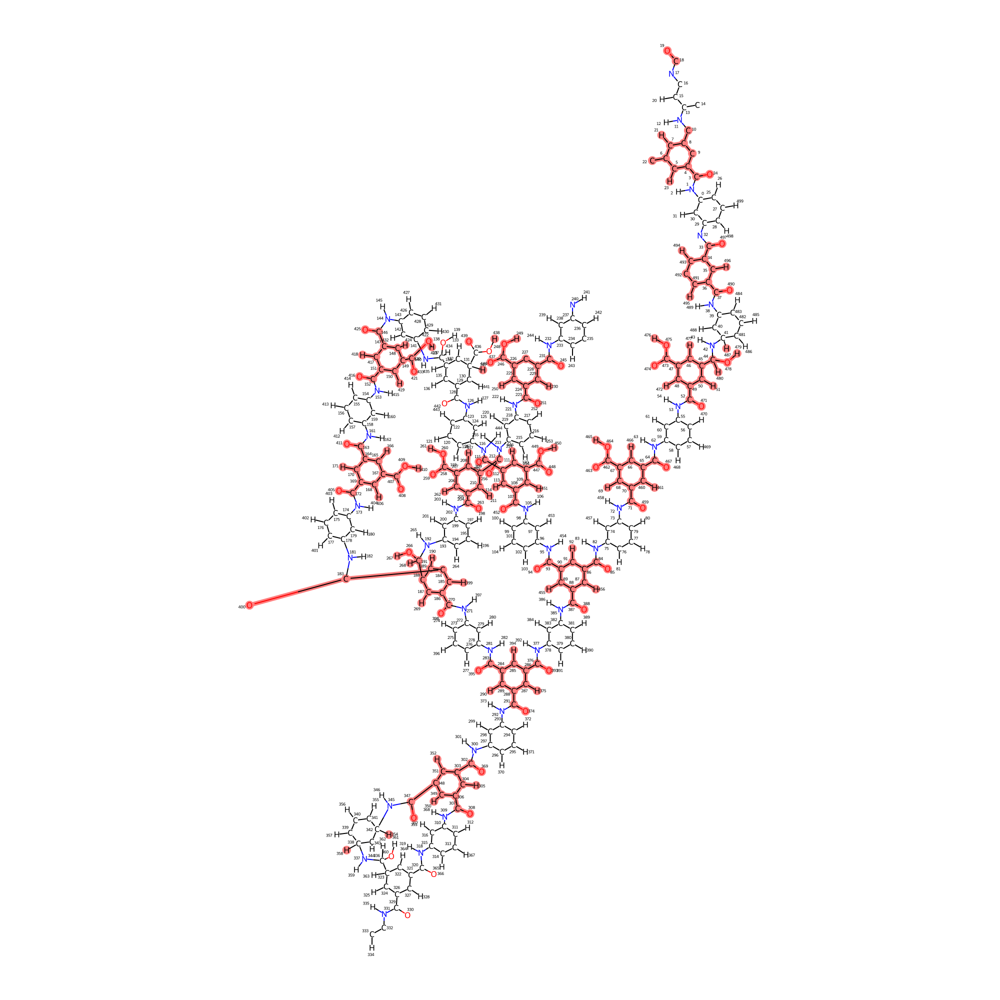

In [2]:
file = 'polymer_examples/rdkit_simple_polymers/polyamide_equil.pdb'
rdmol, new_smarts, smarts_block, selected_atoms, assigned_atoms, unassigned_atoms = create_smarts_substructure(file, 
                                                                                    exclusive_wall_ids=[303, 314], 
                                                                                    seed=312, 
                                                                                    inclusive_wall_ids=[], 
                                                                                    sample_size=500,
                                                                                    sample_seed=6921)
print(smarts_block)
# print(selected_atoms)
rdkit_visualize(rdmol, 2000, 2000, grey_highlight_ids=unassigned_atoms)

## Checking for any stragglers 

In [84]:
assigned_atoms, unassigned_atoms = get_assignments(file)
unassigned_atoms


PolyAmide
[C:1](-[C:2]1-[C:3](-[H:4])-[C:5](-[C:6]-[O:7])-[C:8](-[C:9](-[C:10]-1-[H:11])(-[C:12](-[N:13](-[C:14]1-[C:15](-[C:16](-[C:17](-[C:18](-[C:19]-1-[H:20])-[N:21]-[H:22])-[H:23])-[H:24])-[H:25])-[H:26])(-[O:27]-[H:28])-[H:29])-[H:30])-[H:31])-[O:32]
PolyAmide
[H:1]-[C:2]1-[C:3](-[C:4](-[C:5](-[C:6](-[C:7]-1-[H:8])-[N:9](-[H:10])-[C:11](-[C:12]1-[C:13](-[H:14])-[C:15](-[C:16](-[O:17])-[O:18]-[H:19])(-[C:20](-[C:21](-[C:22]-1-[H:23])-[C:24]-[O:25])-[H:26])-[H:27])-[O:28])-[H:29])-[N:30]-[H:31])-[H:32]
PolyAmide
[C:1](-[C:2]1-[C:3](-[C:4](-[C:5](-[C:6](-[C:7](-[O:8])-[N:9](-[C:10]2-[C:11](-[H:12])-[C:13](-[C:14](-[C:15](-[C:16]-2-[H:17])-[H:18])-[H:19])-[N:20]-[H:21])-[H:22])-[C:23]-1-[H:24])-[H:25])-[C:26]-[O:27])-[H:28])-[O:29]
PolyAmide
[N:1](-[C:2]1-[C:3](-[C:4](-[H:5])-[C:6](-[C:7](-[C:8]-1-[H:9])-[N:10]-[H:11])-[H:12])-[H:13])-[H:14]
PEPTIDE_BOND
[C:1](=[O:2])[N:3]([C:4])
N. of assigned nodes: 6479 -- N. of atoms: 6925
N. of assigned edges: 7190 -- N. of bonds: 7422
0 {'atomi

495 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'H34', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 10, 'connors_atom_name': 'H12'}
Formal charge: 0
496 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'C3_', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 10, 'connors_atom_name': 'C9'}
Formal charge: 0
497 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'C3+', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 10, 'connors_atom_name': 'C1'}
Formal charge: 0
498 {'atomic_number': 8, 'formal_charge': 0, 'atom_name': 'OM', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 10, 'connors_atom_name': 'O3'}
Formal charge: 0
499 {'atomic_number'

984 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'C6^', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 5, 'connors_atom_name': 'C10'}
Formal charge: 0
985 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'H4_', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 5, 'connors_atom_name': 'H2'}
Formal charge: 0
986 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'H4+', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 5, 'connors_atom_name': 'H3'}
Formal charge: 0
987 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'H4(', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 5, 'connors_atom_name': 'H4'}
Formal charge: 0
988 {'atomic_number': 7

1413 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'H6P', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 53, 'connors_atom_name': 'H9'}
Formal charge: 0
1414 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'H6Q', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 53, 'connors_atom_name': 'H8'}
Formal charge: 0
1415 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'H6R', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 53, 'connors_atom_name': 'H7'}
Formal charge: 0
1416 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'C9p', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 53, 'connors_atom_name': 'C1'}
Formal charge: 0
1417 {'atomic_nu

1802 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'CbM', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 29, 'connors_atom_name': 'C1'}
Formal charge: 0
1803 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'CbN', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 29, 'connors_atom_name': 'C6'}
Formal charge: 0
1804 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'CbO', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 29, 'connors_atom_name': 'C5'}
Formal charge: 0
1805 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'H8f', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 29, 'connors_atom_name': 'H5'}
Formal charge: 0
1806 {'atomic_nu

2182 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'H9Z', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 48, 'connors_atom_name': 'H5'}
Formal charge: 0
2183 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'Cd$', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 47, 'connors_atom_name': 'C5'}
Formal charge: 0
2184 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'Cd%', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 71, 'connors_atom_name': 'C3'}
Formal charge: 0
2185 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'Cd^', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 71, 'connors_atom_name': 'C5'}
Formal charge: 0
2186 {'atomic_nu

Formal charge: 0
2652 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'CgO', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 59, 'connors_atom_name': 'C15'}
Formal charge: 0
2653 {'atomic_number': 8, 'formal_charge': 0, 'atom_name': 'O4f', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 59, 'connors_atom_name': 'O2'}
Formal charge: 0
2654 {'atomic_number': 8, 'formal_charge': 0.0, 'atom_name': 'O4g', 'residue_name': 'UNL', 'residue_number': 0}
Formal charge: 0
2655 {'atomic_number': 1, 'formal_charge': 0.0, 'atom_name': 'HbC', 'residue_name': 'UNL', 'residue_number': 0}
Formal charge: 0
2656 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'CgP', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 90, 'connors_atom_name': 'C15'}
Fo

3070 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'Ci~', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 78, 'connors_atom_name': 'C7'}
Formal charge: 0
3071 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'Cj1', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 78, 'connors_atom_name': 'C15'}
Formal charge: 0
3072 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'Cj2', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 103, 'connors_atom_name': 'C13'}
Formal charge: 0
3073 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'Cj3', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 103, 'connors_atom_name': 'C12'}
Formal charge: 0
3074 {'atom

3501 {'atomic_number': 8, 'formal_charge': 0, 'atom_name': 'O5x', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 25, 'connors_atom_name': 'O3'}
Formal charge: 0
3502 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'ClF', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 111, 'connors_atom_name': 'C2'}
Formal charge: 0
3503 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'He!', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 111, 'connors_atom_name': 'H9'}
Formal charge: 0
3504 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'ClG', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 111, 'connors_atom_name': 'C1'}
Formal charge: 0
3505 {'atomic

3841 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'CnK', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 24, 'connors_atom_name': 'C12'}
Formal charge: 0
3842 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'CnL', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 24, 'connors_atom_name': 'C11'}
Formal charge: 0
3843 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'CnM', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 24, 'connors_atom_name': 'C9'}
Formal charge: 0
3844 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'CnN', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 24, 'connors_atom_name': 'C10'}
Formal charge: 0
3845 {'atomic

4298 {'atomic_number': 7, 'formal_charge': 0, 'atom_name': 'N4_', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 111, 'connors_atom_name': 'N1'}
Formal charge: 0
4299 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'Hh<', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 111, 'connors_atom_name': 'H1'}
Formal charge: 0
4300 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'Hh?', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 111, 'connors_atom_name': 'H6'}
Formal charge: 0
4301 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'Cqh', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 122, 'connors_atom_name': 'C11'}
Formal charge: 0
4302 {'atom

4641 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'Hje', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 60, 'connors_atom_name': 'H3'}
Formal charge: 0
4642 {'atomic_number': 7, 'formal_charge': 0, 'atom_name': 'N5a', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 60, 'connors_atom_name': 'N2'}
Formal charge: 0
4643 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'Hjf', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 60, 'connors_atom_name': 'H1'}
Formal charge: 0
4644 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'Hjg', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 60, 'connors_atom_name': 'H5'}
Formal charge: 0
4645 {'atomic_nu

5006 {'atomic_number': 7, 'formal_charge': 0, 'atom_name': 'N5B', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 144, 'connors_atom_name': 'N1'}
Formal charge: 0
5007 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'HkL', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 144, 'connors_atom_name': 'H1'}
Formal charge: 0
5008 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'HkM', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 144, 'connors_atom_name': 'H6'}
Formal charge: 0
5009 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'Cuz', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 144, 'connors_atom_name': 'C5'}
Formal charge: 0
5010 {'atomi

5275 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'Cv~', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 126, 'connors_atom_name': 'C12'}
Formal charge: 0
5276 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'Cw1', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 126, 'connors_atom_name': 'C10'}
Formal charge: 0
5277 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'Cw2', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 126, 'connors_atom_name': 'C9'}
Formal charge: 0
5278 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'HlL', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 126, 'connors_atom_name': 'H4'}
Formal charge: 0
5279 {'ato

5631 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'Cx~', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 15, 'connors_atom_name': 'C6'}
Formal charge: 0
5632 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'Hn2', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 15, 'connors_atom_name': 'H2'}
Formal charge: 0
5633 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'Hn3', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 15, 'connors_atom_name': 'H12'}
Formal charge: 0
5634 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'Cz1', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 15, 'connors_atom_name': 'C9'}
Formal charge: 0
5635 {'atomic_n

5907 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'CyR', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 169, 'connors_atom_name': 'C5'}
Formal charge: 0
5908 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'CyS', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 169, 'connors_atom_name': 'C2'}
Formal charge: 0
5909 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'CyT', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 169, 'connors_atom_name': 'C14'}
Formal charge: 0
5910 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'CyU', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 169, 'connors_atom_name': 'C6'}
Formal charge: 0
5911 {'atom

6296 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'HpX', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 99, 'connors_atom_name': 'H6'}
Formal charge: 0
6297 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'CB<', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 39, 'connors_atom_name': 'C4'}
Formal charge: 0
6298 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'CB?', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 39, 'connors_atom_name': 'C3'}
Formal charge: 0
6299 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'CB>', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 39, 'connors_atom_name': 'C2'}
Formal charge: 0
6300 {'atomic_nu

6630 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'CD&', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 121, 'connors_atom_name': 'C15'}
Formal charge: 0
6631 {'atomic_number': 8, 'formal_charge': 0, 'atom_name': 'O9l', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 121, 'connors_atom_name': 'O2'}
Formal charge: 0
6632 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'Hr1', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 35, 'connors_atom_name': 'H12'}
Formal charge: 0
6633 {'atomic_number': 6, 'formal_charge': 0, 'atom_name': 'CD_', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 35, 'connors_atom_name': 'C9'}
Formal charge: 0
6634 {'atomi

6924 {'atomic_number': 1, 'formal_charge': 0, 'atom_name': 'Ht:', 'residue_name': 'UNL', 'residue_number': 0, 'already_matched': True, 'connors_residue_name': 'PolyAmide', 'connors_residue_number': 38, 'connors_atom_name': 'H9'}
Formal charge: 0
(0, 12) {'bond_order': 1}
(1, 113) {'bond_order': 1}
(2, 3) {'bond_order': 1}
(2, 5) {'bond_order': 1}
(2, 56) {'bond_order': 1}
(3, 4) {'bond_order': 1}
(3, 6) {'bond_order': 1}
(4, 7) {'bond_order': 1}
(4, 58) {'bond_order': 1}
(6, 8) {'bond_order': 1}
(6, 40) {'bond_order': 1}
(9, 10) {'bond_order': 1}
(9, 39) {'bond_order': 1}
(9, 2693) {'bond_order': 1}
(11, 12) {'bond_order': 1}
(11, 14) {'bond_order': 1}
(11, 65) {'bond_order': 1}
(12, 13) {'bond_order': 1}
(13, 16) {'bond_order': 1}
(13, 17) {'bond_order': 1}
(14, 15) {'bond_order': 1}
(14, 66) {'bond_order': 1}
(15, 16) {'bond_order': 1}
(15, 829) {'bond_order': 1}
(16, 18) {'bond_order': 1}
(18, 19) {'bond_order': 1}
(18, 860) {'bond_order': 1}
(20, 22) {'bond_order': 1}
(20, 830) {'b

(403, 404) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(405, 406) {'bond_order': 1}
(405, 3747) {'bond_order': 1}
(407, 408) {'bond_order': 1}
(407, 409) {'bond_order': 1}
(407, 3756) {'bond_order': 1}
(408, 410) {'bond_order': 1}
(408, 3758) {'bond_order': 1}
(410, 411) {'bond_order': 1}
(412, 413) {'bond_order': 1}
(412, 417) {'bond_order': 1}
(412, 3062) {'bond_order': 1}
(413, 414) {'bond_order': 1}
(413, 415) {'bond_order': 1}
(414, 416) {'bond_order': 1}
(414, 3064) {'bond_order': 1}
(416, 419) {'bond_order': 1}
(417, 418) {'bond_order': 1}
(417, 3010) {'bond_order': 1}
(420, 421) {'bond_order': 1}
(420, 423) {'bond_order': 1}
(420, 426) {'bond_order': 1}
(421, 422) {'bond_order': 1}
(421, 430) {'bond_order': 1}
(422, 425) {'bond_order': 1}
(422, 427) {'bond_order': 1}
(423, 424) {'bond_order': 1}
(423, 429) {'bond_order': 1}
(424, 425) {'bond_order': 1}
(424, 428) {'bond_order': 1}
(425, 1161) {'bond_order': 1}
(431, 432) {'bond_order': 1}
(431, 434) {'bond_order': 1}

(776, 777) {'bond_order': 1}
(778, 779) {'bond_order': 1}
(780, 1658) {'bond_order': 1}
(781, 782) {'bond_order': 1}
(781, 815) {'bond_order': 1}
(781, 1784) {'bond_order': 1}
(782, 784) {'bond_order': 1}
(782, 785) {'bond_order': 1}
(783, 784) {'bond_order': 1}
(783, 787) {'bond_order': 1}
(783, 816) {'bond_order': 1}
(784, 786) {'bond_order': 1}
(786, 788) {'bond_order': 1}
(786, 791) {'bond_order': 1}
(789, 791) {'bond_order': 1}
(789, 878) {'bond_order': 1}
(789, 879) {'bond_order': 1}
(790, 879) {'bond_order': 1}
(791, 792) {'bond_order': 1}
(793, 794) {'bond_order': 1}
(793, 796) {'bond_order': 1}
(793, 799) {'bond_order': 1}
(794, 795) {'bond_order': 1}
(794, 800) {'bond_order': 1}
(795, 798) {'bond_order': 1}
(795, 801) {'bond_order': 1}
(796, 797) {'bond_order': 1}
(796, 893) {'bond_order': 1}
(797, 798) {'bond_order': 1}
(797, 894) {'bond_order': 1}
(798, 802) {'bond_order': 1}
(802, 803) {'bond_order': 1}
(802, 809) {'bond_order': 1}
(804, 1788) {'bond_order': 1}
(805, 949) 

(1225, 1275) {'bond_order': 1}
(1228, 2029) {'bond_order': 1}
(1229, 1230) {'bond_order': 1}
(1229, 1232) {'bond_order': 1}
(1229, 1235) {'bond_order': 1}
(1230, 1231) {'bond_order': 1}
(1230, 1236) {'bond_order': 1}
(1231, 1234) {'bond_order': 1}
(1231, 1237) {'bond_order': 1}
(1232, 1233) {'bond_order': 1}
(1232, 1239) {'bond_order': 1}
(1233, 1234) {'bond_order': 1}
(1233, 1240) {'bond_order': 1}
(1234, 1238) {'bond_order': 1}
(1238, 1242) {'bond_order': 1}
(1239, 1241) {'bond_order': 1}
(1243, 1244) {'bond_order': 1}
(1243, 1246) {'bond_order': 1}
(1243, 1249) {'bond_order': 1}
(1244, 1245) {'bond_order': 1}
(1244, 1250) {'bond_order': 1}
(1245, 1248) {'bond_order': 1}
(1245, 1251) {'bond_order': 1}
(1246, 1247) {'bond_order': 1}
(1247, 1248) {'bond_order': 1}
(1247, 1252) {'bond_order': 1}
(1248, 4475) {'bond_order': 1}
(1253, 1254) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(1253, 1256) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(1253, 1259) {'bond_order':

(1598, 4974) {'bond_order': 1}
(1601, 1602) {'bond_order': 1}
(1602, 1603) {'bond_order': 1}
(1602, 1606) {'bond_order': 1}
(1603, 1605) {'bond_order': 1}
(1603, 2535) {'bond_order': 1}
(1604, 1605) {'bond_order': 1}
(1604, 1608) {'bond_order': 1}
(1605, 1607) {'bond_order': 1}
(1607, 1609) {'bond_order': 1}
(1607, 2582) {'bond_order': 1}
(1610, 1611) {'bond_order': 1}
(1610, 1613) {'bond_order': 1}
(1610, 1614) {'bond_order': 1}
(1611, 1612) {'bond_order': 1}
(1611, 1615) {'bond_order': 1}
(1612, 1616) {'bond_order': 1}
(1612, 1676) {'bond_order': 1}
(1613, 1675) {'bond_order': 1}
(1617, 1766) {'bond_order': 1}
(1618, 1619) {'bond_order': 1}
(1618, 1620) {'bond_order': 1}
(1618, 4956) {'bond_order': 1}
(1619, 1621) {'bond_order': 1}
(1619, 4959) {'bond_order': 1}
(1622, 1623) {'bond_order': 1}
(1622, 1639) {'bond_order': 1}
(1622, 4959) {'bond_order': 1}
(1624, 1625) {'bond_order': 1}
(1624, 1749) {'bond_order': 1}
(1624, 1751) {'bond_order': 1}
(1625, 1628) {'bond_order': 1}
(1625, 1

(1972, 1975) {'bond_order': 1}
(1972, 1977) {'bond_order': 1}
(1973, 1974) {'bond_order': 1}
(1973, 1979) {'bond_order': 1}
(1974, 1975) {'bond_order': 1}
(1974, 1978) {'bond_order': 1}
(1975, 2063) {'bond_order': 1}
(1979, 1982) {'bond_order': 1}
(1980, 1981) {'bond_order': 1}
(1983, 1984) {'bond_order': 1}
(1983, 1985) {'bond_order': 1}
(1983, 5205) {'bond_order': 1}
(1984, 1986) {'bond_order': 1}
(1984, 5208) {'bond_order': 1}
(1985, 2740) {'bond_order': 1}
(1987, 1988) {'bond_order': 1}
(1987, 1990) {'bond_order': 1}
(1988, 1989) {'bond_order': 1}
(1988, 1991) {'bond_order': 1}
(1989, 1992) {'bond_order': 1}
(1993, 2875) {'bond_order': 1}
(1994, 1995) {'bond_order': 1}
(1994, 1997) {'bond_order': 1}
(1994, 2000) {'bond_order': 1}
(1995, 1996) {'bond_order': 1}
(1995, 2001) {'bond_order': 1}
(1996, 1999) {'bond_order': 1}
(1996, 2002) {'bond_order': 1}
(1997, 1998) {'bond_order': 1}
(1997, 2004) {'bond_order': 1}
(1998, 1999) {'bond_order': 1}
(1998, 2005) {'bond_order': 1}
(1999, 2

(2378, 2423) {'bond_order': 1}
(2380, 2382) {'bond_order': 1}
(2380, 3231) {'bond_order': 1}
(2380, 3233) {'bond_order': 1}
(2381, 2382) {'bond_order': 1}
(2381, 2384) {'bond_order': 1}
(2381, 2536) {'bond_order': 1}
(2382, 2383) {'bond_order': 1}
(2383, 2385) {'bond_order': 1}
(2383, 2434) {'bond_order': 1}
(2386, 2387) {'bond_order': 1}
(2386, 5744) {'bond_order': 1}
(2386, 5746) {'bond_order': 1}
(2387, 2390) {'bond_order': 1}
(2387, 2391) {'bond_order': 1}
(2388, 2389) {'bond_order': 1}
(2388, 5744) {'bond_order': 1}
(2388, 6590) {'bond_order': 1}
(2389, 2390) {'bond_order': 1}
(2389, 2393) {'bond_order': 1}
(2390, 2392) {'bond_order': 1}
(2392, 2394) {'bond_order': 1}
(2392, 2449) {'bond_order': 1}
(2395, 2396) {'bond_order': 1}
(2395, 2458) {'bond_order': 1}
(2397, 2398) {'bond_order': 1}
(2397, 3316) {'bond_order': 1}
(2397, 3420) {'bond_order': 1}
(2399, 2444) {'bond_order': 1}
(2399, 2461) {'bond_order': 1}
(2399, 3316) {'bond_order': 1}
(2400, 2401) {'bond_order': 1}
(2400, 2

(2813, 2814) {'bond_order': 1}
(2813, 2816) {'bond_order': 1}
(2817, 2818) {'bond_order': 1}
(2817, 2819) {'bond_order': 1}
(2817, 2820) {'bond_order': 1}
(2819, 2883) {'bond_order': 1}
(2822, 2823) {'bond_order': 1}
(2822, 2825) {'bond_order': 1}
(2822, 2827) {'bond_order': 1}
(2823, 2824) {'bond_order': 1}
(2823, 2830) {'bond_order': 1}
(2824, 2826) {'bond_order': 1}
(2824, 2828) {'bond_order': 1}
(2825, 6165) {'bond_order': 1}
(2825, 6167) {'bond_order': 1}
(2825, 6761) {'bond_order': 1}
(2826, 2829) {'bond_order': 1}
(2826, 6165) {'bond_order': 1}
(2829, 2832) {'bond_order': 1}
(2829, 6128) {'bond_order': 1}
(2830, 2831) {'bond_order': 1}
(2830, 2833) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(2833, 2834) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(2835, 2836) {'bond_order': 1}
(2835, 2838) {'bond_order': 1}
(2835, 2841) {'bond_order': 1}
(2836, 2837) {'bond_order': 1}
(2836, 2845) {'bond_order': 1}
(2837, 2840) {'bond_order': 1}
(2837, 2842) {'bond_order':

(3175, 3181) {'bond_order': 1}
(3176, 3177) {'bond_order': 1}
(3176, 3182) {'bond_order': 1}
(3177, 3178) {'bond_order': 1}
(3177, 3183) {'bond_order': 1}
(3178, 6381) {'bond_order': 1}
(3182, 3184) {'bond_order': 1}
(3182, 3195) {'bond_order': 1}
(3185, 6381) {'bond_order': 1}
(3186, 3187) {'bond_order': 1}
(3186, 3190) {'bond_order': 1}
(3187, 3189) {'bond_order': 1}
(3187, 3191) {'bond_order': 1}
(3188, 3189) {'bond_order': 1}
(3188, 3193) {'bond_order': 1}
(3189, 3192) {'bond_order': 1}
(3192, 3194) {'bond_order': 1}
(3192, 3199) {'bond_order': 1}
(3195, 3196) {'bond_order': 1}
(3195, 3347) {'bond_order': 1}
(3197, 3199) {'bond_order': 1}
(3199, 3200) {'bond_order': 1}
(3201, 3202) {'bond_order': 1}
(3201, 3204) {'bond_order': 1}
(3201, 3205) {'bond_order': 1}
(3202, 3203) {'bond_order': 1}
(3202, 3207) {'bond_order': 1}
(3202, 6782) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(3203, 3206) {'bond_order': 1}
(3203, 6398) {'bond_order': 1}
(3204, 6397) {'bond_order': 1}
(3

(3604, 3607) {'bond_order': 1}
(3606, 3608) {'bond_order': 1}
(3607, 3609) {'bond_order': 1}
(3612, 3613) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(3612, 3615) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(3612, 3618) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(3613, 3614) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(3613, 3623) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(3614, 3617) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(3614, 3619) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(3615, 3616) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(3615, 3621) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(3616, 3617) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(3616, 3620) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(3617, 3622) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(3621, 3625) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(3622, 3626) {'bond_ord

(4057, 4060) {'bond_order': 1}
(4058, 4059) {'bond_order': 1}
(4060, 4061) {'bond_order': 1}
(4060, 6827) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(4061, 6828) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(4062, 4811) {'bond_order': 1}
(4063, 4064) {'bond_order': 1}
(4063, 4067) {'bond_order': 1}
(4064, 4065) {'bond_order': 1}
(4064, 4066) {'bond_order': 1}
(4065, 4068) {'bond_order': 1}
(4067, 4069) {'bond_order': 1}
(4068, 4109) {'bond_order': 1}
(4068, 6424) {'bond_order': 1}
(4070, 4071) {'bond_order': 1}
(4070, 4155) {'bond_order': 1}
(4070, 4157) {'bond_order': 1}
(4071, 4074) {'bond_order': 1}
(4071, 4075) {'bond_order': 1}
(4072, 4073) {'bond_order': 1}
(4072, 4077) {'bond_order': 1}
(4072, 4155) {'bond_order': 1}
(4073, 4074) {'bond_order': 1}
(4073, 4078) {'bond_order': 1}
(4074, 4076) {'bond_order': 1}
(4076, 4080) {'bond_order': 1}
(4076, 4137) {'bond_order': 1}
(4077, 4079) {'bond_order': 1}
(4077, 4130) {'bond_order': 1}
(4081, 4082) {'bond_order':

(4430, 4584) {'bond_order': 1}
(4433, 4436) {'bond_order': 1}
(4433, 6842) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(4434, 4435) {'bond_order': 1}
(4434, 4437) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(4436, 6843) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(4437, 4588) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(4438, 4447) {'bond_order': 1}
(4438, 4543) {'bond_order': 1}
(4438, 5478) {'bond_order': 1}
(4438, 6844) {'bond_order': 1}
(4441, 5338) {'bond_order': 1}
(4442, 4443) {'bond_order': 1}
(4442, 4444) {'bond_order': 1}
(4442, 5340) {'bond_order': 1}
(4443, 4445) {'bond_order': 1}
(4443, 5339) {'bond_order': 1}
(4445, 4446) {'bond_order': 1}
(4447, 5327) {'bond_order': 1}
(4447, 6845) {'bond_order': 1}
(4452, 4453) {'bond_order': 1}
(4452, 4456) {'bond_order': 1}
(4452, 5362) {'bond_order': 1}
(4453, 4454) {'bond_order': 1}
(4453, 4457) {'bond_order': 1}
(4454, 4455) {'bond_order': 1}
(4454, 4458) {'bond_order': 1}
(4455, 4459) {'

(4746, 4823) {'bond_order': 1}
(4746, 4892) {'bond_order': 1}
(4748, 4896) {'bond_order': 1}
(4749, 4912) {'bond_order': 1}
(4750, 4751) {'bond_order': 1}
(4750, 4819) {'bond_order': 1}
(4752, 4753) {'bond_order': 1}
(4752, 4755) {'bond_order': 1}
(4753, 4754) {'bond_order': 1}
(4753, 4758) {'bond_order': 1}
(4754, 4757) {'bond_order': 1}
(4754, 4759) {'bond_order': 1}
(4755, 4756) {'bond_order': 1}
(4756, 4757) {'bond_order': 1}
(4756, 4761) {'bond_order': 1}
(4757, 4760) {'bond_order': 1}
(4760, 4762) {'bond_order': 1}
(4760, 4801) {'bond_order': 1}
(4763, 4764) {'bond_order': 1}
(4763, 4766) {'bond_order': 1}
(4763, 4769) {'bond_order': 1}
(4764, 4765) {'bond_order': 1}
(4764, 4770) {'bond_order': 1}
(4765, 4768) {'bond_order': 1}
(4765, 4771) {'bond_order': 1}
(4766, 4767) {'bond_order': 1}
(4766, 5838) {'bond_order': 1}
(4767, 4768) {'bond_order': 1}
(4767, 4773) {'bond_order': 1}
(4768, 4772) {'bond_order': 1}
(4772, 4791) {'bond_order': 1}
(4775, 4776) {'bond_order': 1}
(4777, 4

(5262, 5263) {'bond_order': 1}
(5262, 5264) {'bond_order': 1}
(5262, 5266) {'bond_order': 1}
(5264, 5265) {'bond_order': 1}
(5264, 5268) {'bond_order': 1}
(5265, 5267) {'bond_order': 1}
(5268, 5269) {'bond_order': 1}
(5268, 5479) {'bond_order': 1}
(5270, 5271) {'bond_order': 1}
(5270, 5399) {'bond_order': 1}
(5270, 5400) {'bond_order': 1}
(5272, 5273) {'bond_order': 1}
(5272, 5399) {'bond_order': 1}
(5274, 5275) {'bond_order': 1}
(5274, 5276) {'bond_order': 1}
(5274, 5278) {'bond_order': 1}
(5275, 5279) {'bond_order': 1}
(5276, 5277) {'bond_order': 1}
(5280, 5281) {'bond_order': 1}
(5280, 5336) {'bond_order': 1}
(5283, 5417) {'bond_order': 1}
(5284, 5285) {'bond_order': 1}
(5284, 5431) {'bond_order': 1}
(5286, 5319) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(5286, 5431) {'bond_order': 1}
(5286, 5433) {'bond_order': 1}
(5287, 5288) {'bond_order': 1}
(5287, 5290) {'bond_order': 1}
(5287, 5293) {'bond_order': 1}
(5288, 5289) {'bond_order': 1}
(5288, 5294) {'bond_order': 1}
(5

(5579, 5582) {'bond_order': 1}
(5580, 5581) {'bond_order': 1}
(5581, 5584) {'bond_order': 1}
(5581, 5585) {'bond_order': 1}
(5582, 5583) {'bond_order': 1}
(5582, 5587) {'bond_order': 1}
(5583, 5584) {'bond_order': 1}
(5583, 5588) {'bond_order': 1}
(5584, 5586) {'bond_order': 1}
(5586, 5590) {'bond_order': 1}
(5586, 5808) {'bond_order': 1}
(5587, 5589) {'bond_order': 1}
(5587, 5637) {'bond_order': 1}
(5591, 5592) {'bond_order': 1}
(5591, 5651) {'bond_order': 1}
(5594, 5595) {'bond_order': 1}
(5594, 5597) {'bond_order': 1}
(5594, 5600) {'bond_order': 1}
(5595, 5596) {'bond_order': 1}
(5596, 5599) {'bond_order': 1}
(5596, 5601) {'bond_order': 1}
(5597, 5598) {'bond_order': 1}
(5597, 5603) {'bond_order': 1}
(5598, 5599) {'bond_order': 1}
(5598, 5604) {'bond_order': 1}
(5599, 5602) {'bond_order': 1}
(5602, 5606) {'bond_order': 1}
(5602, 5642) {'bond_order': 1}
(5603, 5605) {'bond_order': 1}
(5603, 5634) {'bond_order': 1}
(5607, 5608) {'bond_order': 1}
(5607, 5610) {'bond_order': 1}
(5607, 5

(5910, 5913) {'bond_order': 1}
(5913, 5915) {'bond_order': 1}
(5914, 5916) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(5916, 5917) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(5919, 5921) {'bond_order': 1}
(5922, 5923) {'bond_order': 1}
(5922, 5924) {'bond_order': 1}
(5922, 6686) {'bond_order': 1}
(5923, 5925) {'bond_order': 1}
(5925, 5926) {'bond_order': 1}
(5930, 5931) {'bond_order': 1}
(5930, 5932) {'bond_order': 1}
(5930, 5933) {'bond_order': 1}
(5931, 5934) {'bond_order': 1}
(5932, 5935) {'bond_order': 1}
(5935, 5936) {'bond_order': 1}
(5935, 5991) {'bond_order': 1}
(5938, 5939) {'bond_order': 1}
(5938, 5941) {'bond_order': 1}
(5938, 5944) {'bond_order': 1}
(5939, 5940) {'bond_order': 1}
(5939, 5945) {'bond_order': 1}
(5940, 5943) {'bond_order': 1}
(5940, 5946) {'bond_order': 1}
(5941, 5942) {'bond_order': 1}
(5941, 5948) {'bond_order': 1}
(5942, 5943) {'bond_order': 1}
(5942, 5949) {'bond_order': 1}
(5943, 5947) {'bond_order': 1}
(5947, 5951) {'bond_order':

(6335, 6336) {'bond_order': 1}
(6335, 6345) {'bond_order': 1}
(6336, 6339) {'bond_order': 1}
(6336, 6341) {'bond_order': 1}
(6337, 6338) {'bond_order': 1}
(6337, 6343) {'bond_order': 1}
(6338, 6339) {'bond_order': 1}
(6338, 6342) {'bond_order': 1}
(6339, 6344) {'bond_order': 1}
(6343, 6346) {'bond_order': 1}
(6344, 6347) {'bond_order': 1}
(6349, 6350) {'bond_order': 1}
(6349, 6351) {'bond_order': 1}
(6349, 6427) {'bond_order': 1}
(6350, 6352) {'bond_order': 1}
(6350, 6514) {'bond_order': 1}
(6352, 6410) {'bond_order': 1}
(6352, 6516) {'bond_order': 1}
(6353, 6354) {'bond_order': 1}
(6353, 6355) {'bond_order': 1}
(6354, 6356) {'bond_order': 1}
(6358, 6359) {'bond_order': 1}
(6358, 6361) {'bond_order': 1}
(6358, 6364) {'bond_order': 1}
(6359, 6360) {'bond_order': 1}
(6359, 6365) {'bond_order': 1}
(6360, 6363) {'bond_order': 1}
(6360, 6366) {'bond_order': 1}
(6361, 6362) {'bond_order': 1}
(6361, 6368) {'bond_order': 1}
(6362, 6363) {'bond_order': 1}
(6362, 6369) {'bond_order': 1}
(6363, 6

(6665, 6669) {'bond_order': 1}
(6670, 6671) {'bond_order': 1}
(6672, 6673) {'bond_order': 1}
(6672, 6675) {'bond_order': 1}
(6672, 6678) {'bond_order': 1}
(6673, 6674) {'bond_order': 1}
(6673, 6681) {'bond_order': 1}
(6673, 6921) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(6674, 6677) {'bond_order': 1}
(6675, 6676) {'bond_order': 1}
(6675, 6679) {'bond_order': 1}
(6676, 6677) {'bond_order': 1}
(6677, 6680) {'bond_order': 1}
(6677, 6922) {'bond_order': 1}
(6679, 6683) {'bond_order': 1}
(6680, 6923) {'bond_order': 1}
(6681, 6682) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(6686, 6687) {'bond_order': 1}
(6687, 6688) {'bond_order': 1}
(6687, 6689) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(6689, 6690) {'bond_order': rdkit.Chem.rdchem.BondType.UNSPECIFIED}
(6692, 6924) {'bond_order': 1}
Number of atoms before sanitization: 6925


{45,
 46,
 50,
 101,
 158,
 164,
 244,
 245,
 331,
 347,
 404,
 554,
 555,
 623,
 632,
 633,
 634,
 635,
 638,
 685,
 686,
 762,
 937,
 952,
 953,
 1021,
 1034,
 1110,
 1164,
 1165,
 1253,
 1254,
 1255,
 1256,
 1257,
 1258,
 1259,
 1260,
 1261,
 1262,
 1263,
 1264,
 1265,
 1266,
 1267,
 1268,
 1269,
 1277,
 1319,
 1331,
 1332,
 1406,
 1478,
 1479,
 1840,
 1841,
 1954,
 2065,
 2250,
 2251,
 2267,
 2268,
 2278,
 2282,
 2346,
 2369,
 2421,
 2440,
 2441,
 2574,
 2575,
 2586,
 2587,
 2647,
 2648,
 2654,
 2655,
 2658,
 2659,
 2714,
 2715,
 2728,
 2729,
 2760,
 2773,
 2774,
 2833,
 2834,
 2846,
 2849,
 2886,
 2887,
 2888,
 2889,
 2890,
 2891,
 2892,
 2893,
 2894,
 2895,
 2896,
 2897,
 2898,
 2899,
 2900,
 2901,
 2902,
 2995,
 2996,
 3049,
 3211,
 3281,
 3357,
 3358,
 3391,
 3392,
 3436,
 3442,
 3443,
 3444,
 3445,
 3446,
 3447,
 3448,
 3449,
 3450,
 3451,
 3452,
 3453,
 3454,
 3455,
 3456,
 3495,
 3499,
 3612,
 3613,
 3614,
 3615,
 3616,
 3617,
 3618,
 3619,
 3620,
 3621,
 3622,
 3623,
 3624,

In [85]:
mol.visualize(backend='rdkit', height=3000, width=3000, highlight_ids=list(unassigned_atoms))

2] unrecognized bond type[22:17:02] unrecognized bond type[22:17:02] unrecognized bond type[22:17:02] unrecognized bond type[22:17:02] unrecognized bond type[22:17:02] unrecognized bond type[22:17:02] unrecognized bond type[22:17:02] unrecognized bond type[22:17:02] unrecognized bond type[22:17:02] unrecognized bond type[22:17:02] unrecognized bond type[22:17:02] unrecognized bond type[22:37:48] unrecognized bond type[22:37:48] unrecognized bond type[22:37:48] unrecognized bond type[22:37:48] unrecognized bond type[22:37:48] unrecognized bond type[22:37:48] unrecognized bond type[22:37:48] unrecognized bond type[22:37:48] unrecognized bond type[22:37:48] unrecognized bond type[22:37:48] unrecognized bond type[22:37:48] unrecognized bond type[22:37:48] unrecognized bond type[22:37:48] unrecognized bond type[22:37:48] unrecognized bond type[22:37:48] unrecognized bond type[22:37:48] unrecognized bond type[22:37:48] unrecognized bond type[22:37:48] unrecognized bond type[22:37:48] unrecog

] unrecognized bond type[22:37:48] unrecognized bond type[22:37:48] unrecognized bond type[22:37:48] unrecognized bond type[22:37:48] unrecognized bond type[22:37:48] unrecognized bond type[22:37:48] unrecognized bond type[22:37:48] unrecognized bond type[22:37:48] unrecognized bond type[22:37:48] unrecognized bond type[22:37:48] unrecognized bond type[22:37:48] unrecognized bond type[22:37:48] unrecognized bond type[22:37:48] unrecognized bond type[22:37:48] unrecognized bond type[22:37:48] unrecognized bond type[22:37:48] unrecognized bond type[22:37:48] unrecognized bond type[22:37:48] unrecognized bond type[22:37:48] unrecognized bond type[22:37:48] unrecognized bond type[22:37:48] unrecognized bond type[22:37:48] unrecognized bond type[22:37:48] unrecognized bond type[22:37:48] unrecognized bond type[22:37:48] unrecognized bond type[22:37:48] unrecognized bond type[22:37:48] unrecognized bond type[22:37:48] unrecognized bond type[22:37:48] unrecognized bond type[22:37:48] unrecogn

In [62]:
file = 'polymer_examples/rdkit_simple_polymers/polyamide_equil.pdb'
rdmol, new_smarts, smarts_block, selected_atoms = create_smarts_substructure(file, 
                                                                           exclusive_wall_ids=[1], 
                                                                           seed=2, 
                                                                           inclusive_wall_ids=[], 
                                                                           sample_size=20,
                                                                           sample_seed=1)
# print(smarts_block)
# print(selected_atoms)
view = rdkit_visualize(rdmol, 500, 500, show_3D=True)
view

NGLWidget()

In [65]:
rdmol.MolToPDBBlock()

AttributeError: 'Mol' object has no attribute 'MolToPDBBlock'

In [63]:
dir(view)

['__class__',
 '__del__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__getitem__',
 '__getstate__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__iter__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__setstate__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_add_notifiers',
 '_add_shape',
 '_call_widget_constructed',
 '_camera_orientation',
 '_camera_str',
 '_clear_component_auto_completion',
 '_comm_changed',
 '_compare',
 '_coordinates_dict',
 '_create_ibtn_fullscreen',
 '_create_player',
 '_cross_validation_lock',
 '_default_keys',
 '_display_callbacks',
 '_display_image',
 '_display_repr',
 '_dom_classes',
 '_dry_run',
 '_event',
 '_execute_js_code',
 '_fire_callbacks',
 '_gen_repr_from_keys',
 '_get_embed_state',
 '_get_full_params',
 '_get_remote_call_msg',
 '_get_trait_default_generator',
 '_g